# Final project - House Price prediction

## Data description
Using house sale price dataset for King County, USA. Dataset from https://www.kaggle.com/datasets/harlfoxem/housesalesprediction  

## Variable description  
Variables description from https://geodacenter.github.io/data-and-lab/KingCounty-HouseSales2015/ 
  
1) id : identification  
2) date : date sold  
3) price : dependent variable  
4) bedrooms : number of bedrooms  
5) bathrooms : number of bathrooms, where .5 accounts for a room with a toilet but no shower    
6) sqft_living : living area in sqrt ft  
7) sqrt_lot : lot area in sqrt ft  
8) floors : number of floors  
9) waterfront : "1" if waterfront exists and "0" otherwise (binary)  
10) view : ordinary variable from 0 to 4 indicating how good the view is: 0 = No view, 1 = Fair 2 = Average, 3 = Good, 4 = Excellent  
11) condition : ordinary variable indicating the condition of the house from 1 to 5; An index from 1 to 5 on the condition of the apartment: 1 = Poor- Worn out, 2 = Fair- Badly worn, 3 = Average, 4 = Good, 5= Very Good   
12) grade : construction quality (from 1 to 13); the higher, the better , where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design.  
13) sqft_above : sqrt ft above the ground  
14) sqft_basement : sqrt ft below the ground  
15) yr_built : year built  
16) yr_renovated : year renovated and '0' if not renovated  
17) zipcode  
18) lat : latitude  
19) long : longitude  
20) sqrt_living15 : average size of interior housing living space for the closest 15 houses, in square feet  
21) sqrt_lot15 : average size of land lots for the closest 15 houses, in square feet


## 목차
### 1. EDA
분석 방향을 결정하기 위한 기본적 EDA 
### 2. Modeling
- 사용하는 모형에 대한 설명과 분석 결과, MCMC 등의 수렴 여부와 결과에 대한 해석  
- Posterior predictive check 또는 residual analysis 등을 통한 모형 진단 

## summary
1. Model 1 - Hierarchical model with riverside random effect (Best model)
2. Model 2 - Simple Linear Model
3. Model 3 - Hierarchical model with new_grade random effect

## 1. EDA

In [26]:
### library
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings

# from scipy.stats import multivariate_normal
# from numpy.linalg import inv
import seaborn as sns
import folium
import matplotlib.cm as cm
import matplotlib.colors as colors

import pystan
# from cmdstanpy import CmdStanModel

warnings.filterwarnings('ignore')
warnings.simplefilter(action='ignore', category=FutureWarning)
plt.rcParams['figure.facecolor'] = 'white'
np.set_printoptions(suppress=True)
pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', lambda x: '%.3f' % x)  # pd.reset_option('display.float_format')

In [27]:
house = pd.read_csv('./kc_house_data.csv', parse_dates=['date'])
house.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,2014-10-13,221900.000,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,98178,47.511,-122.257,1340,5650
1,6414100192,2014-12-09,538000.000,3,2.250,2570,7242,2.000,0,0,3,7,2170,400,1951,1991,98125,47.721,-122.319,1690,7639
2,5631500400,2015-02-25,180000.000,2,1.000,770,10000,1.000,0,0,3,6,770,0,1933,0,98028,47.738,-122.233,2720,8062
3,2487200875,2014-12-09,604000.000,4,3.000,1960,5000,1.000,0,0,5,7,1050,910,1965,0,98136,47.521,-122.393,1360,5000
4,1954400510,2015-02-18,510000.000,3,2.000,1680,8080,1.000,0,0,3,8,1680,0,1987,0,98074,47.617,-122.045,1800,7503


In [28]:
# 분석용 데이터 저장해두기
df = house.copy()

In [29]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21613 non-null  int64         
 1   date           21613 non-null  datetime64[ns]
 2   price          21613 non-null  float64       
 3   bedrooms       21613 non-null  int64         
 4   bathrooms      21613 non-null  float64       
 5   sqft_living    21613 non-null  int64         
 6   sqft_lot       21613 non-null  int64         
 7   floors         21613 non-null  float64       
 8   waterfront     21613 non-null  int64         
 9   view           21613 non-null  int64         
 10  condition      21613 non-null  int64         
 11  grade          21613 non-null  int64         
 12  sqft_above     21613 non-null  int64         
 13  sqft_basement  21613 non-null  int64         
 14  yr_built       21613 non-null  int64         
 15  yr_renovated   2161

In [30]:
df['date'].describe()

count                            21613
mean     2014-10-29 04:38:01.959931648
min                2014-05-02 00:00:00
25%                2014-07-22 00:00:00
50%                2014-10-16 00:00:00
75%                2015-02-17 00:00:00
max                2015-05-27 00:00:00
Name: date, dtype: object

In [31]:
df['yr_renovated_or_built'] = np.where(df["yr_renovated"] == 0, df["yr_built"], df["yr_renovated"])
df['yr_renovated_or_built'] = pd.to_datetime(df['yr_renovated_or_built'], format='%Y')
df['yr_renovated_or_built'].describe()

count                            21613
mean     1973-05-21 14:55:59.644658320
min                1900-01-01 00:00:00
25%                1954-01-01 00:00:00
50%                1977-01-01 00:00:00
75%                1999-01-01 00:00:00
max                2015-01-01 00:00:00
Name: yr_renovated_or_built, dtype: object

In [32]:
## age
# date 컬럼의 년, 월, 일 중에서 년과 월만 추출
df['yr_month'] = df['date'].dt.to_period('M')
# yr_built 컬럼의 년, 월, 일 중에서 년과 월만 추출
df['yr_month_built'] = df['yr_renovated_or_built'].dt.to_period('M')

# 두 날짜 간의 개월 수 차이를 계산
df['age'] = (df['yr_month'] - df['yr_month_built']).apply(lambda x: x.n)
df['age'].describe()

count   21613.000
mean      496.818
std       345.743
min        -8.000
25%       191.000
50%       448.000
75%       727.000
max      1384.000
Name: age, dtype: float64

In [33]:
# df[df['age'] < 0]  # 18개  # yr_built보다 date가 빠르거나(데이터 오류) renovated한 경우에 대해서 발생 -> age = 0

In [34]:
df['age'] = np.where(df['age'] < 0, 0, df['age'])
df['age'].describe()

count   21613.000
mean      496.822
std       345.737
min         0.000
25%       191.000
50%       448.000
75%       727.000
max      1384.000
Name: age, dtype: float64

In [35]:
## log price
df['log_price'] = np.log(df['price'])

In [36]:
df['is_renovated'] = np.where(df['yr_renovated'] != 0, 1, 0)
df['is_renovated'].describe()

count   21613.000
mean        0.042
std         0.201
min         0.000
25%         0.000
50%         0.000
75%         0.000
max         1.000
Name: is_renovated, dtype: float64

In [37]:
# renovated 비중이 어느정도 되는가
np.sum(df['is_renovated']) / len(df)  # 5% 정도 renovated
# 어떤 집들이 Renovated 되었나 밑에서 봤는데 오래된 집들. 다 2000년도 전에 지어진 집들

# # renovated
# np.unique(df[df['is_renovated'] == 1]['yr_built'].dt.year, return_counts=True)
# np.sum(df[df['is_renovated'] == 1]['yr_built'].dt.year > 2000)
# # not renovated
# np.unique(df[df['is_renovated'] != 1]['yr_built'].dt.year, return_counts=True)
# np.sum(df[df['is_renovated'] != 1]['yr_built'].dt.year > 2000) / len(df[df['is_renovated'] != 1])

0.042289362883449776

In [38]:
np.unique(df['grade'], return_counts=True)

(array([ 1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13]),
 array([   1,    3,   29,  242, 2038, 8981, 6068, 2615, 1134,  399,   90,
          13]))

In [39]:
df['new_grade'] = np.where(df['grade'] <= 6, 6, df['grade'])
# 12 13은 높으니까 10이랑 뭉개는 등의 너무 뭉개지 말자.
df['new_grade'] = np.where(df['grade'] > 11, 11, df['new_grade'])

np.unique(df['new_grade'], return_counts=True)

(array([ 6,  7,  8,  9, 10, 11]), array([2313, 8981, 6068, 2615, 1134,  502]))

In [40]:
np.unique(df[df['is_renovated'] == 1]['yr_built'], return_counts=True)

(array([1900, 1901, 1902, 1903, 1904, 1905, 1906, 1907, 1908, 1909, 1910,
        1911, 1912, 1913, 1914, 1915, 1916, 1917, 1918, 1919, 1920, 1921,
        1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932,
        1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943,
        1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954,
        1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965,
        1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976,
        1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987,
        1988, 1989, 1990, 1991, 1996, 1998, 2003]),
 array([19,  1,  2,  6,  6, 17,  8, 14, 14, 16, 17, 14, 14, 10,  9, 11,  8,
         5, 13, 15, 10,  7, 18, 10, 20, 16, 16,  8, 10,  4, 20,  4,  5,  7,
         8,  5,  5, 13,  7, 11, 14, 17, 24, 18, 12,  8, 11, 18, 17, 16, 31,
        17, 17, 17, 14, 17,  9, 11, 10,  9,  9,  4, 16, 14,  3, 11,  1, 10,
        19, 11,  7,  4,  7,  4,  5,  4,  7,  8,  4, 

In [41]:
np.sum(df['is_renovated']) / len(df)

0.042289362883449776

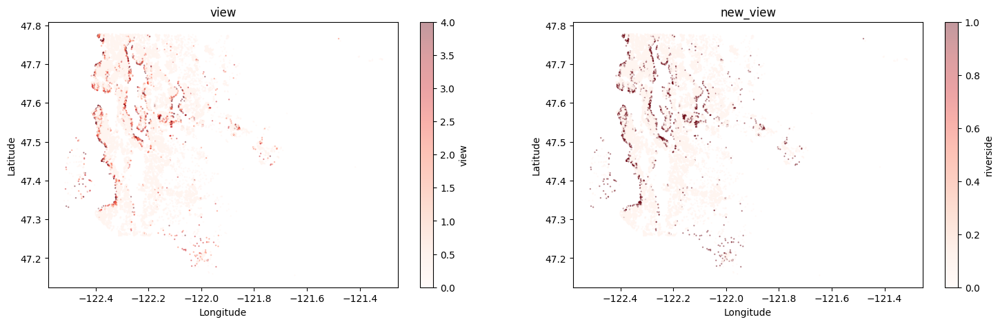

In [42]:
# New view; binary => To find riverside
df['new_view'] = np.where(df['view'] > 1, 1, 0)

plt.figure(figsize=(18,5))

plt.subplot(1, 2, 1)
plt.scatter(x=df['long'], y=df['lat'], c=df['view'], cmap='Reds', alpha=0.4, s=0.5)
plt.colorbar(label='view')
plt.title('view')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.subplot(1, 2, 2)
plt.scatter(x=df['long'], y=df['lat'], c=df['new_view'], cmap='Reds', alpha=0.4, s=0.5)
plt.colorbar(label='riverside')
plt.title('new_view')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()
# view=='0'인 것들은 안보임

In [43]:
# If waterfront exists, then almost has view
df.groupby(['new_view', 'waterfront']).size().unstack()

waterfront,0,1
new_view,,
0,19820,1
1,1630,162


In [44]:
# Is riverside??
df['new_waterfront'] = np.where((df['new_view'] == 1) | (df['waterfront'] == 1), 1, 0)
np.unique(df['new_waterfront'], return_counts=True)

(array([0, 1]), array([19820,  1793]))

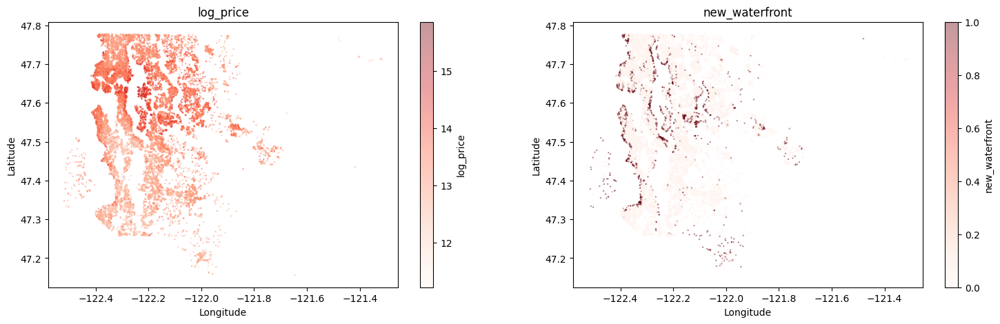

In [46]:
plt.figure(figsize=(18,5))

plt.subplot(1, 2, 1)
plt.scatter(x=df['long'], y=df['lat'], c=df['log_price'], cmap='Reds', alpha=0.4, s=0.5)
plt.colorbar(label='log_price')
plt.title('log_price')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.subplot(1, 2, 2)
plt.scatter(x=df['long'], y=df['lat'], c=df['new_waterfront'], cmap='Reds', alpha=0.4, s=0.5)
plt.colorbar(label='new_waterfront')
plt.title('new_waterfront')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

# view=='0'인 것들은 안보임

In [47]:
# nearby river
# longitude: 경도(가로), latitude: 위도(세로)
from scipy.spatial import distance_matrix

# Pair-wise 거리 계산n
distances = np.triu(distance_matrix(df[['lat', 'long']], df[['lat', 'long']]))

# [2, 3, 5, 19]번 컬럼과 거리가 0.01 미만인 점들의 인덱스 찾기
idx_riverside = np.where(df['new_waterfront'] == 1)[0]
threshold = 0.005  # 이전에는 0.01

# 각 컬럼에 대해 찾은 인덱스를 저장할 리스트
indices_set = set()

# 각 선택된 컬럼에 대해 반복
for col in idx_riverside:
    # 거리가 threshold 미만인 점들의 인덱스 찾기
    close_points = np.where((distances[:, col] > 0.0) & (distances[:, col] < threshold))

    # 찾은 인덱스를 리스트에 추가
    indices_set.update(close_points[0])
    
indices_set = np.array(list(indices_set))
print(len(indices_set) / len(df))

df['riverside'] = np.zeros(len(df))
df.iloc[indices_set, -1] = 1
for i in range(df.shape[0]):
    if df.iloc[i, :]['new_waterfront'] == 1:
        df.iloc[i, -1] = 1
# 21598   0
df['riverside'] = df['riverside'].astype(int)
# df.head()

0.22597510757414518


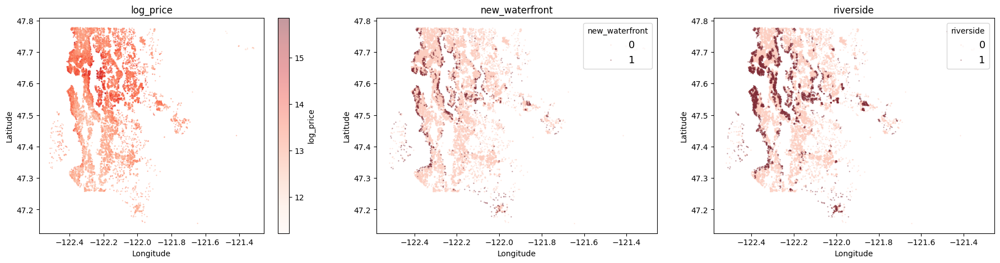

In [154]:
plt.figure(figsize=(22, 5))

plt.subplot(1, 3, 1)
plt.scatter(x=df['long'], y=df['lat'], c=df['log_price'], cmap='Reds', alpha=0.4, s=0.5)
plt.colorbar(label='log_price')
plt.title('log_price')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.subplot(1, 3, 2)
plt.scatter(x=df[df['new_waterfront'] == 0]['long'], y=df[df['new_waterfront'] == 0]['lat'], c='#FCCDBF', alpha=0.4, s=0.5, label='0')
plt.scatter(x=df[df['new_waterfront'] == 1]['long'], y=df[df['new_waterfront'] == 1]['lat'], c='#802C36', alpha=0.4, s=0.5, label='1')
plt.legend(loc=1, title='new_waterfront', fontsize=13)
plt.title('new_waterfront')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.subplot(1, 3, 3)
plt.scatter(x=df[df['riverside'] == 0]['long'], y=df[df['riverside'] == 0]['lat'], c='#FCCDBF', alpha=0.4, s=0.5, label='0')
plt.scatter(x=df[df['riverside'] == 1]['long'], y=df[df['riverside'] == 1]['lat'], c='#802C36', alpha=0.4, s=0.5, label='1')
plt.legend(loc=1, title='riverside', fontsize=13)
plt.title('riverside')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

# view=='0'인 것들은 안보임

### 0.01로 threshold 잡았을때. 이땐 50%가 리버사이드

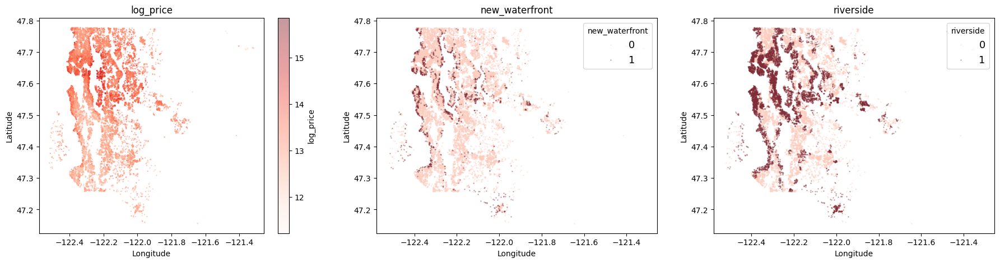

In [60]:
# plt.figure(figsize=(22, 5))

# plt.subplot(1, 3, 1)
# plt.scatter(x=df['long'], y=df['lat'], c=df['log_price'], cmap='Reds', alpha=0.4, s=0.5)
# plt.colorbar(label='log_price')
# plt.title('log_price')
# plt.xlabel('Longitude')
# plt.ylabel('Latitude')

# plt.subplot(1, 3, 2)
# plt.scatter(x=df[df['riverside'] == 0]['long'], y=df[df['riverside'] == 0]['lat'], c='#FCCDBF', alpha=0.4, s=0.5, label='0')
# plt.scatter(x=df[df['riverside'] == 1]['long'], y=df[df['riverside'] == 1]['lat'], c='#802C36', alpha=0.4, s=0.5, label='1')
# plt.legend(loc=1, title='new_waterfront', fontsize=13)
# plt.title('new_waterfront')
# plt.xlabel('Longitude')
# plt.ylabel('Latitude')

# plt.subplot(1, 3, 3)
# plt.scatter(x=df[df['nearby_temp'] == 0]['long'], y=df[df['nearby_temp'] == 0]['lat'], c='#FCCDBF', alpha=0.4, s=0.5, label='0')
# plt.scatter(x=df[df['nearby_temp'] == 1]['long'], y=df[df['nearby_temp'] == 1]['lat'], c='#802C36', alpha=0.4, s=0.5, label='1')
# plt.legend(loc=1, title='riverside', fontsize=13)
# plt.title('riverside')
# plt.xlabel('Longitude')
# plt.ylabel('Latitude')

# plt.show()

# # view=='0'인 것들은 안보임

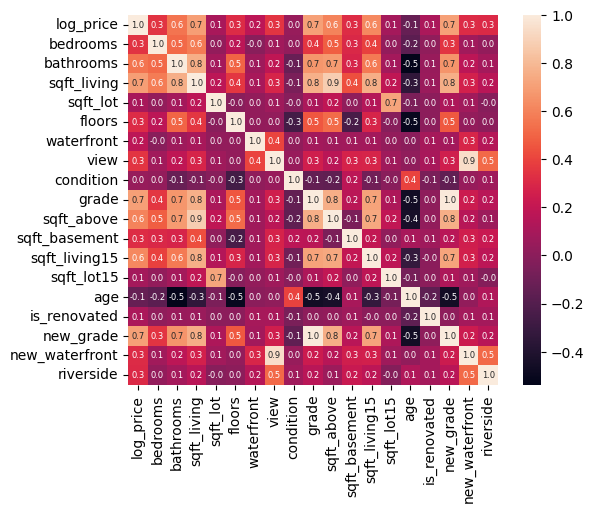

In [156]:
var_corr = ['log_price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15', 'age', 'is_renovated',
       'new_grade', 'new_waterfront', 'riverside']
sns.heatmap(df[var_corr].corr(),
            square=True, 
            annot=True,
            annot_kws={"fontsize":6},
            fmt='.1f')
plt.show()

In [31]:
corr_log_price = df[var_corr].corr().iloc[:, 0]
corr_log_price[(corr_log_price > 0.2) | (corr_log_price < -0.2)]

log_price       1.000
bedrooms        0.344
bathrooms       0.551
sqft_living     0.695
floors          0.311
view            0.347
grade           0.704
sqft_above      0.602
sqft_basement   0.317
sqft_living15   0.619
new_grade       0.700
riverside       0.313
nearby          0.263
Name: log_price, dtype: float64

In [159]:
con_var = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15', 'age']
dis_var = ['bedrooms', 'bathrooms', 'floors', 'waterfront', 'view', 'condition', 'grade', 'is_renovated', 'new_grade', 'new_waterfront', 'riverside']

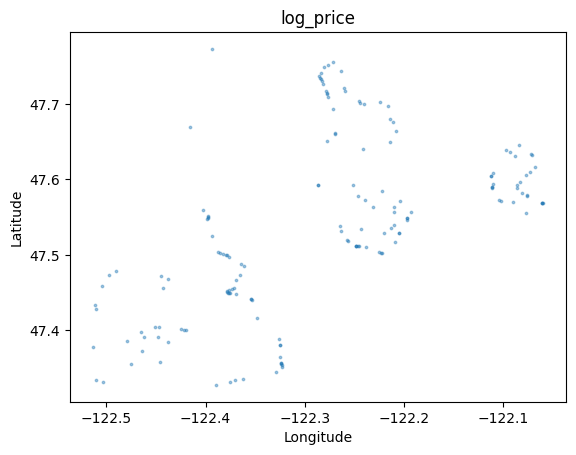

In [194]:
# plt.figure(figsize=(22, 5))

# plt.subplot(1, 3, 1)
temp = df[df['waterfront']==1]
plt.scatter(x=temp['long'], y=temp['lat'], alpha=0.4, s=3)
# plt.colorbar(label='log_price')
plt.title('log_price')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
# view=='0'인 것들은 안보임
# plt.legend()
plt.show()

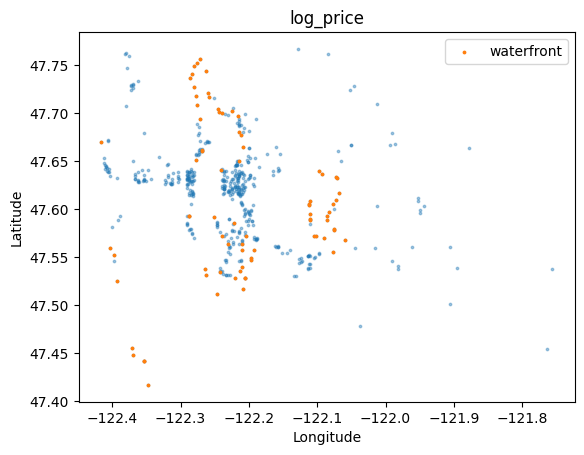

In [188]:
# plt.figure(figsize=(22, 5))

# plt.subplot(1, 3, 1)
temp = df[df['price'] > 1.5 * 1e6]
plt.scatter(x=temp['long'], y=temp['lat'], alpha=0.4, s=3)
# plt.colorbar(label='log_price')
plt.title('log_price')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
temp2 = temp[temp['waterfront'] ==1]
plt.scatter(x=temp2['long'], y=temp2['lat'], alpha=1, s=3, label='waterfront')
# view=='0'인 것들은 안보임
plt.legend()
plt.show()

In [198]:
import folium
import matplotlib.cm as cm
import matplotlib.colors as colors

# price 컬럼에 대한 로그 변환 수행
# df['log_price'] = np.log(df['price'])

# King County의 중심 좌표
location = temp['lat'].mean(), temp['long'].mean()

# Folium Map 객체 생성
m = folium.Map(location=location, zoom_start=10)

# DataFrame의 각 행에 대해 지도에 원형 마커 추가
for idx, row in temp.iterrows():
    folium.CircleMarker(
        location=(row['lat'], row['long']),
        radius=2,
        fill=True,
        # color=colors.rgb2hex(cmap(norm(row['log_price']))),  # colormap에 로그 가격을 매핑하여 색상 설정
        fill_opacity=1.0,  
    ).add_to(m)

# 지도 출력
m

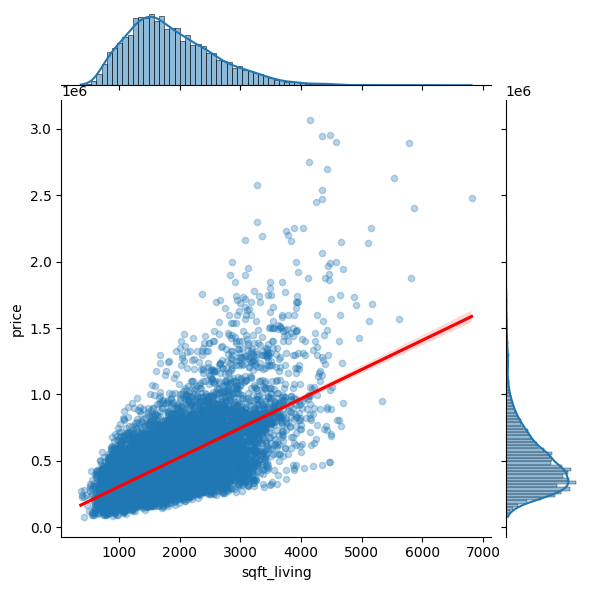

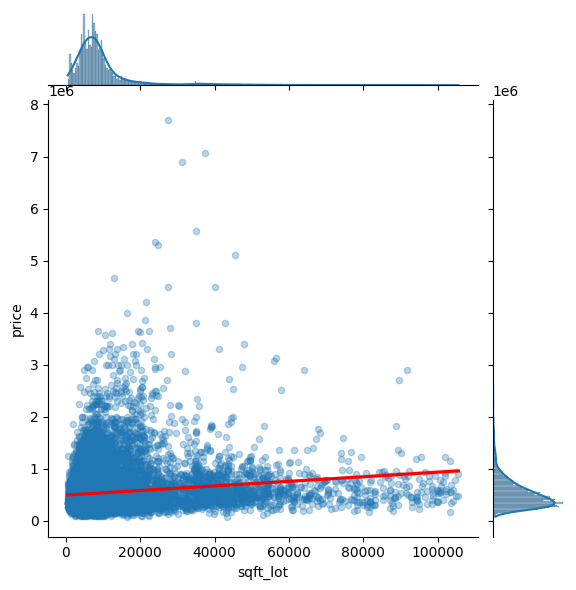

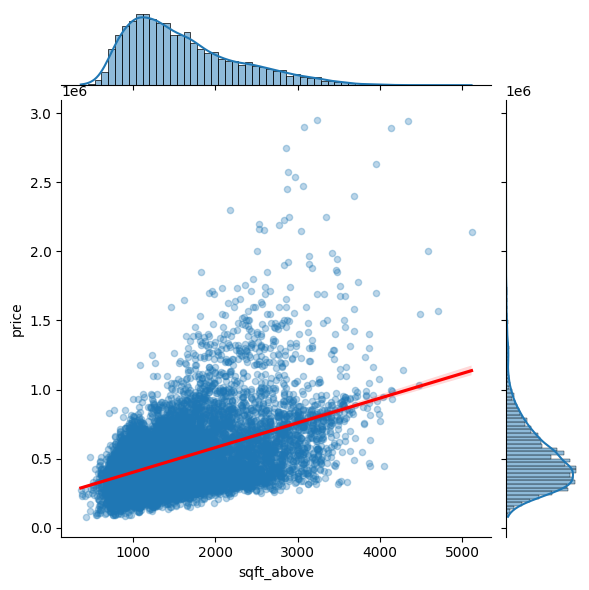

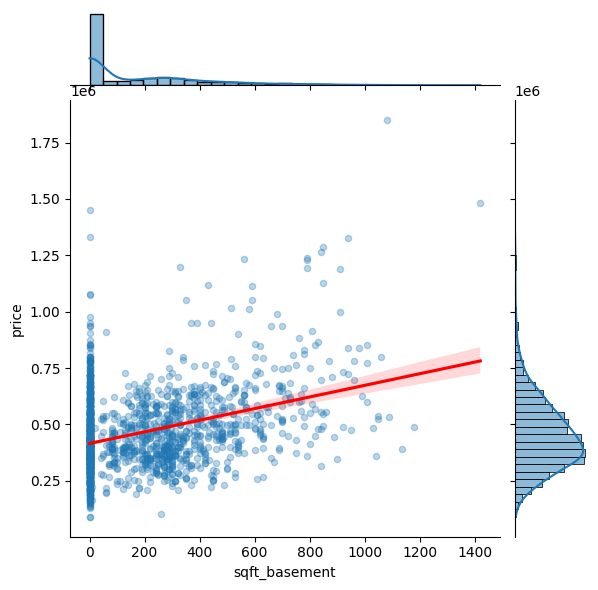

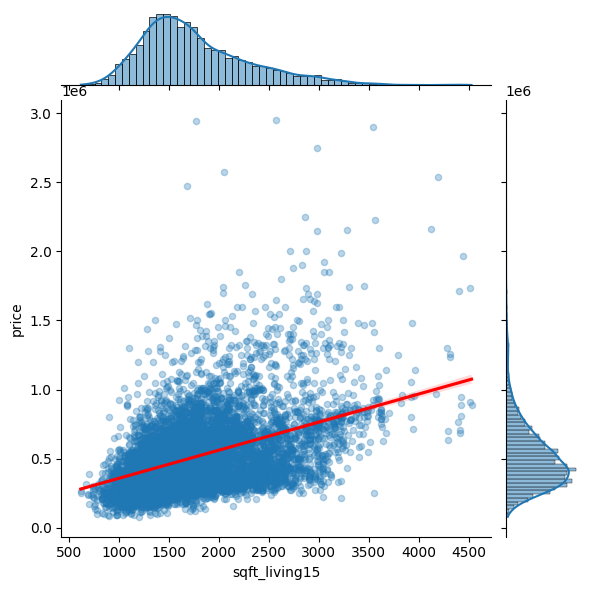

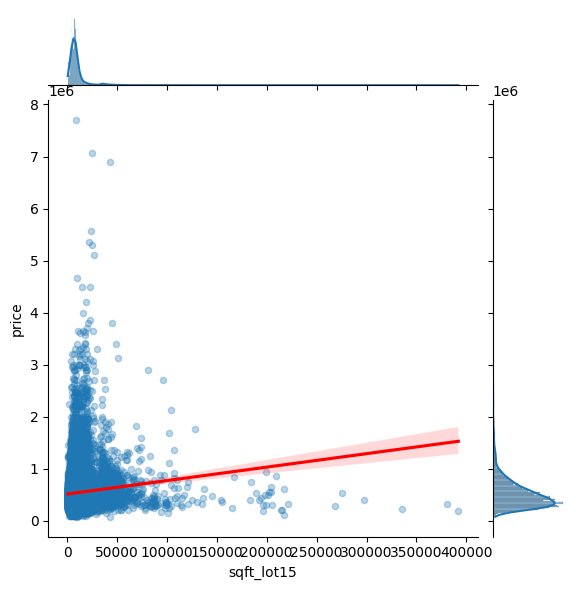

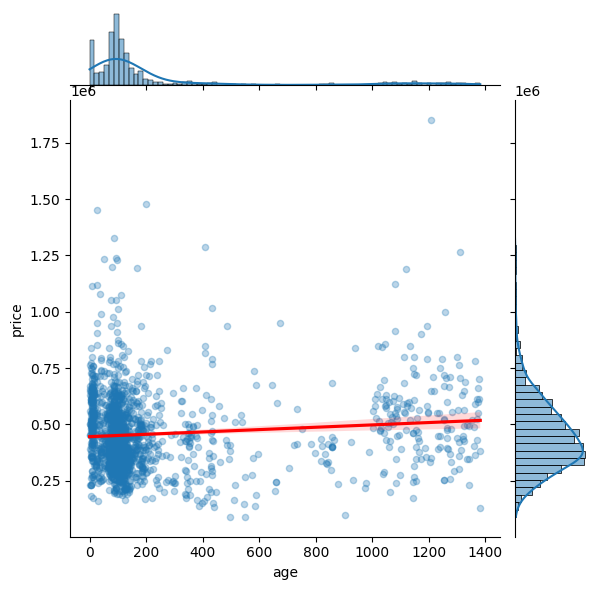

In [160]:
# 극단치 제거하고 그리기 - 0.05 ~ 0.95 quantile안에 있는 관측치
for variable in con_var:
    Q1 = df[variable].quantile(0.05)
    Q3 = df[variable].quantile(0.95)
    IQR = Q3 - Q1

    df_filtered = df[~((df[variable] < (Q1 - 1.5 * IQR)) |(df['sqft_lot'] > (Q3 + 1.5 * IQR)))]

    sns.jointplot(x=variable,
                y="price",
                data=df_filtered, 
                kind='reg', 
                height=6, 
                scatter_kws={"s": 20, 'alpha':0.3},     # marker size
                line_kws={"color": "red"}  # line color
                )
plt.show()

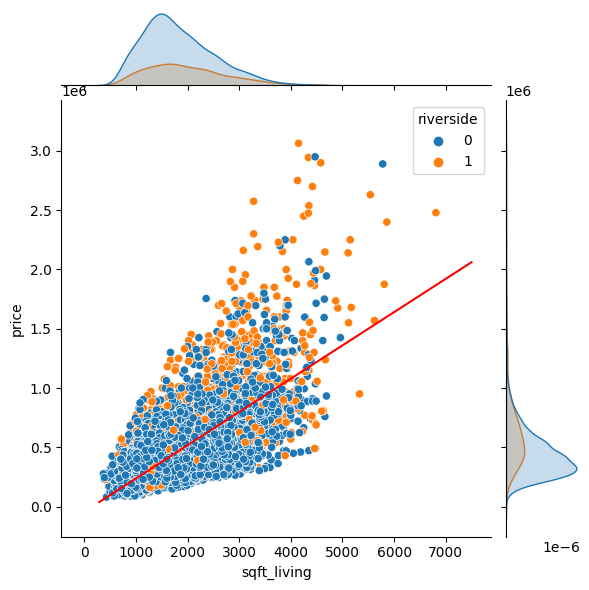

In [162]:
from sklearn.linear_model import LinearRegression

# 극단치 제거하고 그리기 - 0.05 ~ 0.95 quantile안에 있는 관측치
for variable in ['sqft_living']:
    Q1 = df[variable].quantile(0.05)
    Q3 = df[variable].quantile(0.95)
    IQR = Q3 - Q1

    df_filtered = df[~((df[variable] < (Q1 - 1.5 * IQR)) |(df['sqft_lot'] > (Q3 + 1.5 * IQR)))]

    sns.jointplot(x=variable,
                y="price",
                data=df_filtered, 
                hue='riverside',
                # kind='reg', 
                height=6, 
                # scatter_kws={"s": 20, 'alpha':0.3},     # marker size
                # line_kws={"color": "red"}  # line color
                )
    # 회귀 분석
    model = LinearRegression().fit(df[['sqft_living']], df['price'])
    x_range = np.linspace(df['sqft_living'].min(), 7500, 100)
    y = model.predict(x_range.reshape(-1, 1))

    # regression lines
    plt.plot(x_range, y, color='red')

plt.show()

In [177]:
sum(df['waterfront']) / len(df), sum(df['new_view']) / len(df)

(0.007541757275713691, 0.08291306158330634)

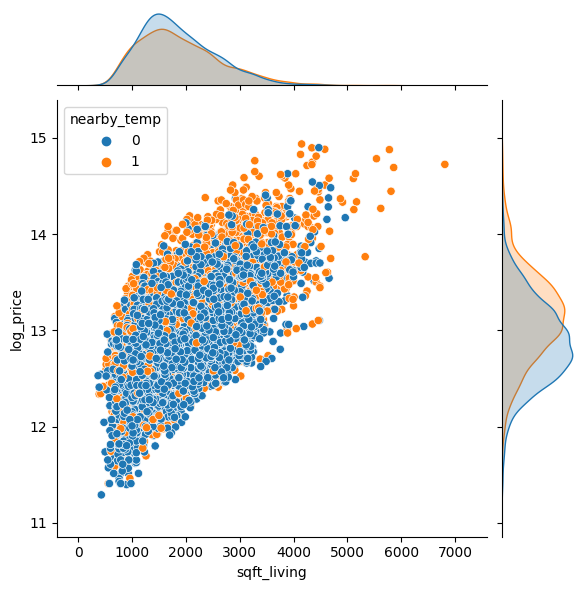

In [67]:
# 극단치 제거하고 그리기 - 0.05 ~ 0.95 quantile안에 있는 관측치
for variable in ['sqft_living']:
    Q1 = df[variable].quantile(0.05)
    Q3 = df[variable].quantile(0.95)
    IQR = Q3 - Q1

    df_filtered = df[~((df[variable] < (Q1 - 1.5 * IQR)) |(df['sqft_lot'] > (Q3 + 1.5 * IQR)))]

    sns.jointplot(x=variable,
                y="log_price",
                data=df_filtered, 
                hue='nearby_temp',
                # kind='reg', 
                height=6, 
                # scatter_kws={"s": 20, 'alpha':0.3},     # marker size
                # line_kws={"color": "red"}  # line color
                )
plt.show()

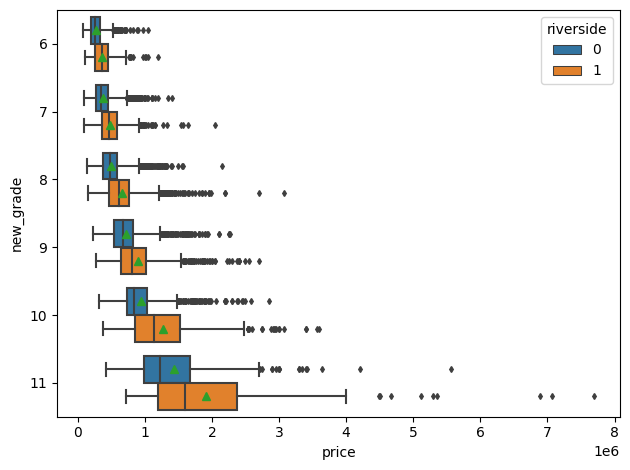

In [166]:
# nearby 변수 구분이 들어간 new_grade에 따른 price 분포
# plt.figure(figsize=(11, 5))
sns.boxplot(y='new_grade',
            x='price', 
            data=df, 
            width=0.8,
            orient='h',
            showmeans=True, 
            hue='riverside',
            fliersize=3)
plt.tight_layout()
plt.show()

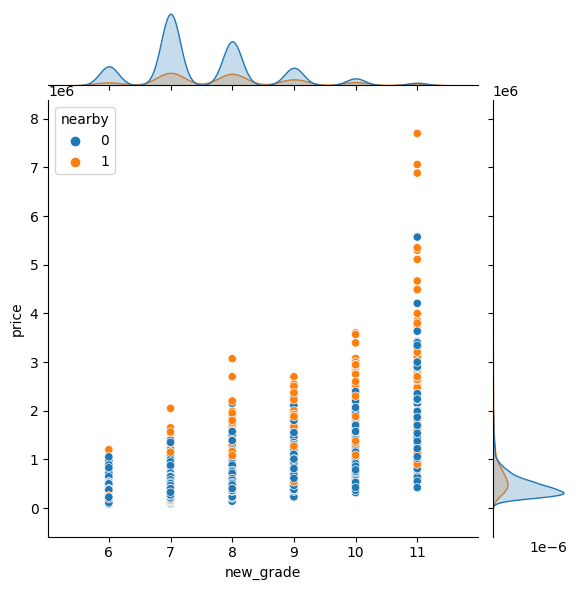

In [80]:
# 극단치 제거하고 그리기 - 0.05 ~ 0.95 quantile안에 있는 관측치
for variable in ['new_grade']:
    sns.jointplot(x=variable,
                y="price",
                data=df, 
                hue='nearby',
                # kind='reg', 
                height=6, 
                # scatter_kws={"s": 20, 'alpha':0.3},     # marker size
                # line_kws={"color": "red"}  # line color
                )
plt.show()

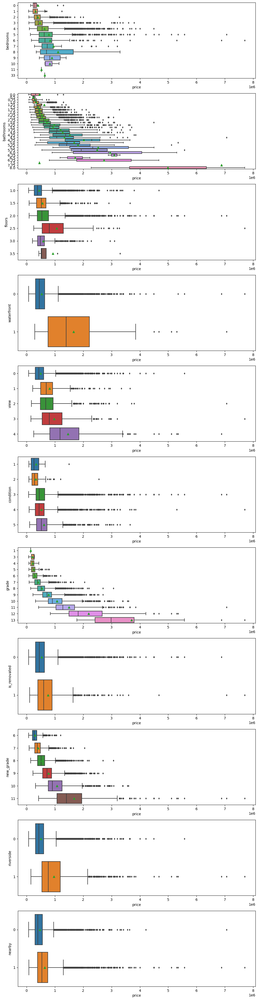

In [37]:
# condition 등과 log price와의 관계
fig, axarr = plt.subplots(len(dis_var), figsize=(12,50))
for i, var in enumerate(dis_var):
    sns.boxplot(y=var,
                x='price', 
                data=df, 
                width=0.8,
                orient='h',
                showmeans=True, 
                fliersize=3, 
                ax = axarr[i])
plt.show()

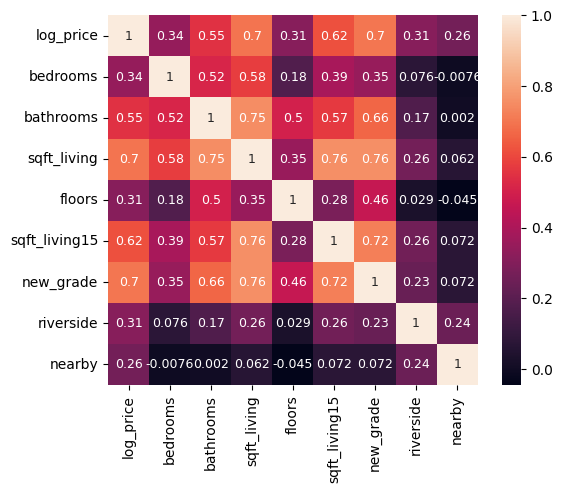

In [39]:
var_corr = ['log_price', 'bedrooms', 'bathrooms', 'sqft_living', 'floors', 'sqft_living15', 'new_grade', 'riverside', 'nearby']  # 'sqft_living',
sns.heatmap(df[var_corr].corr(),
            square=True,
            annot=True, 
            annot_kws={"fontsize": 9})
plt.show()

# is_renovated 필요 없음

In [40]:
# use_variables = ['log_price', 'bedrooms', 'bathrooms', 'sqft_living', 'floors', 'waterfront', 'view', 'sqft_living15', 'new_grade', 'riverside']
# use_variables = ['log_price', 'bedrooms', 'bathrooms', 'sqft_living', 'floors', 'waterfront', 'sqft_living15', 'new_grade', 'riverside']
use_variables = ['log_price', 'bedrooms', 'bathrooms', 'sqft_living', 'floors', 'new_grade', 'riverside', 'nearby']
df2 = df[use_variables]
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   log_price    21613 non-null  float64
 1   bedrooms     21613 non-null  int64  
 2   bathrooms    21613 non-null  float64
 3   sqft_living  21613 non-null  int64  
 4   floors       21613 non-null  float64
 5   new_grade    21613 non-null  int64  
 6   riverside    21613 non-null  int64  
 7   nearby       21613 non-null  int64  
dtypes: float64(3), int64(5)
memory usage: 1.3 MB


In [41]:
df2.describe()

,log_price,bedrooms,bathrooms,sqft_living,floors,new_grade,riverside,nearby
count,21613.000,21613.000,21613.000,21613.000,21613.000,21613.000,21613.000,21613.000
mean,13.048,3.371,2.115,2079.900,1.494,7.666,0.083,0.419
std,0.527,0.930,0.770,918.441,0.540,1.128,0.276,0.493
min,11.225,0.000,0.000,290.000,1.000,6.000,0.000,0.000
25%,12.682,3.000,1.750,1427.000,1.000,7.000,0.000,0.000
50%,13.017,3.000,2.250,1910.000,1.500,7.000,0.000,0.000
75%,13.377,4.000,2.500,2550.000,2.000,8.000,0.000,1.000
max,15.857,33.000,8.000,13540.000,3.500,11.000,1.000,1.000


In [42]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df2_transformed = df2.copy()
df2_transformed.loc[:, ['sqft_living']] = scaler.fit_transform(df2_transformed.loc[:, ['sqft_living']])
df2_transformed.describe()

,log_price,bedrooms,bathrooms,sqft_living,floors,new_grade,riverside,nearby
count,21613.000,21613.000,21613.000,21613.000,21613.000,21613.000,21613.000,21613.000
mean,13.048,3.371,2.115,0.000,1.494,7.666,0.083,0.419
std,0.527,0.930,0.770,1.000,0.540,1.128,0.276,0.493
min,11.225,0.000,0.000,-1.949,1.000,6.000,0.000,0.000
25%,12.682,3.000,1.750,-0.711,1.000,7.000,0.000,0.000
50%,13.017,3.000,2.250,-0.185,1.500,7.000,0.000,0.000
75%,13.377,4.000,2.500,0.512,2.000,8.000,0.000,1.000
max,15.857,33.000,8.000,12.478,3.500,11.000,1.000,1.000


## Modeling

### Model 1 - Hierarchical model (Full dataset)

$$
\begin{aligned}
\text{Likelihood} \quad &y \sim N(X_1 \beta_{fix} + X_2 \beta_{ran}, \sigma^2 I_n), \quad \beta_{ran} \sim N_J(0_J, \tau^2 I_J)\\
\text{Prior} \quad &\sigma^2 \sim \text{Inv-gamma}(0.3, 0.5) \\
&\beta_{fix} \sim N(0, 1000 I_p) \\
&\tau^2 \sim \text{Inv-gamma}(0.05, 0.05)
\end{aligned}
$$

$$
\begin{aligned}
X_2 = 
\begin{pmatrix} 
1_{n_1} & 0_{n_1}\\
0_{n_2} & 1_{n_2} \\
\end{pmatrix}
\end{aligned}
$$

$$
\begin{aligned}
\beta_{ran} =
\begin{pmatrix}
\beta_{ran, 1} \\ \beta_{ran, 2}
\end{pmatrix}, \quad
\beta_{ran, i} \sim N(0, \tau^2), \quad
i = 1, \dots, 6
\end{aligned}
$$

#### Model Compile

In [ ]:
# Mixed model with non-informative prior
model_reg4 = """ 
data {              
  int<lower=0> N;    // number of data items
  int<lower=0> p;    // number of predictors
  real y[N];          // response
  row_vector[p] X[N];  // predictor

  int<lower=1> L;    // num of group 2
  int<lower=1,upper=L> ll[N];  // group indicator
}
parameters {  
  real<lower=0> tau1;  // var of random effect beta_ran          
  real<lower=0> tau2;  // var of epsilon
  vector[p] beta;      // fixed effect
  real u[L];           // mixed effect
}
transformed parameters {
  real tau;    // var for random effect
  real sigma;  // var for error term
  sigma = 1 / sqrt(tau2);
  tau = 1 / sqrt(tau1);
}
model {
  // priors for beta and sigma^2
  for (i in 1:p){
    beta[i] ~ normal(0.0, 1000);  // noninformative prior
  }
  tau2 ~ gamma(0.3, 0.5);        // related to sigma 
  tau1 ~ gamma(0.05, 0.05);      // related to tau
  for (l in 1:L){
    u[l] ~ normal(0, tau);
  }
  // likelihood
  for (n in 1:N){
   y[n] ~ normal(X[n] * beta + u[ll[n]], sigma); 
  }
}

generated quantities{
  real Y_mean[N];
  real Y_pred[N];
  for(i in 1:N){
    // Posterior parameter distribution of the mean
    Y_mean[i] = X[i] * beta + u[ll[i]];
    // Posterior predictive distribution
    Y_pred[i] = normal_rng(Y_mean[i], sigma);
  }
}
""" 

sm = pystan.StanModel(model_code = model_reg4)

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_0a9f4ba5e7097608d94fa5aa06d19f88 NOW.
In file included from /var/folders/4y/7tgg1kws66z0gg7gpxn2pdd40000gn/T/pystan_m6j53ynb/stanfit4anon_model_0a9f4ba5e7097608d94fa5aa06d19f88_4120158698081841957.cpp:836:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/arrayobject.h:5:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/ndarrayobject.h:12:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/ndarraytypes.h:1940:
/Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/npy_1_7_deprecated_api.h:17:2: warning: "Using deprecated NumPy API, disable it with "          "#define NPY_NO_DEPRECATED_API NPY_1_7_API_VERSION" [-W#warnings]
#warning "Using deprecated NumPy API, disable it with " \
 ^
In file included from /var/folders/4y/7tgg1kws66z0gg7gpxn2p

#### Fit the model

In [66]:
import statsmodels.tools as sm_tools

# response variable
y = df2_transformed['log_price']
# predictor variables
X = df2_transformed.drop(columns=['log_price', 'nearby']).copy()
X = sm_tools.add_constant(X)  # add intercept term
# group indicator variable
group = df2_transformed['nearby'] + 1
group = group.astype(int)

print(np.unique(group))
X.head()

[1 2]


,const,bedrooms,bathrooms,sqft_living,floors,new_grade,riverside
0,1.000,3,1.000,-0.980,1.000,7,0
1,1.000,3,2.250,0.534,2.000,7,0
2,1.000,2,1.000,-1.426,1.000,6,0
3,1.000,4,3.000,-0.131,1.000,7,0
4,1.000,3,2.000,-0.435,1.000,8,0


In [67]:
n = X.shape[0]
p = X.shape[1]
L = len(np.unique(group))  # num of groups
print(n, p, L)

21613 7 2


In [68]:
fit5 = sm.sampling(
  data={'N': n, 'p': p, 'X': X, 'y': y, 'L': L, 'll': group},    # named list of data
  chains = 3,             # number of Markov chains
  warmup = 2000,          # number of warmup iterations per chain
  iter = 4000,            # total number of iterations per chain
  # control = list(adapt_delta=0.99),  # this may help
  # control = list(max_treedepth=16),  # this may help
  n_jobs = 1               # number of cores (could use one per chain), 
)


Gradient evaluation took 0.004425 seconds
1000 transitions using 10 leapfrog steps per transition would take 44.25 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 4000 [  0%]  (Warmup)
Iteration:  400 / 4000 [ 10%]  (Warmup)
Iteration:  800 / 4000 [ 20%]  (Warmup)
Iteration: 1200 / 4000 [ 30%]  (Warmup)
Iteration: 1600 / 4000 [ 40%]  (Warmup)
Iteration: 2000 / 4000 [ 50%]  (Warmup)
Iteration: 2001 / 4000 [ 50%]  (Sampling)
Iteration: 2400 / 4000 [ 60%]  (Sampling)
Iteration: 2800 / 4000 [ 70%]  (Sampling)
Iteration: 3200 / 4000 [ 80%]  (Sampling)
Iteration: 3600 / 4000 [ 90%]  (Sampling)
Iteration: 4000 / 4000 [100%]  (Sampling)

 Elapsed Time: 2879.67 seconds (Warm-up)
               3296.86 seconds (Sampling)
               6176.53 seconds (Total)


Gradient evaluation took 0.00579 seconds
1000 transitions using 10 leapfrog steps per transition would take 57.9 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 4000 [  0%]  (Warmup)
Iteration:  400 

Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:
Exception: normal_lpdf: Scale parameter is 0, but must be > 0!  (in 'unknown file name' at line 31)

If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,
but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

Informational Message: The current Metropolis proposal is about to be rejected because of the following issue:
Exception: normal_lpdf: Scale parameter is 0, but must be > 0!  (in 'unknown file name' at line 31)

If this warning occurs sporadically, such as for highly constrained variable types like covariance matrices, then the sampler is fine,
but if this warning occurs often then your model may be either severely ill-conditioned or misspecified.

To run all diagnostics call pystan.check_hmc_diagnostics(fit)


Gradient evaluation took 0.00564 seconds
1000 transitions using 10 leapfrog steps per transition would take 56.4 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 4000 [  0%]  (Warmup)
Iteration:  400 / 4000 [ 10%]  (Warmup)
Iteration:  800 / 4000 [ 20%]  (Warmup)
Iteration: 1200 / 4000 [ 30%]  (Warmup)
Iteration: 1600 / 4000 [ 40%]  (Warmup)
Iteration: 2000 / 4000 [ 50%]  (Warmup)
Iteration: 2001 / 4000 [ 50%]  (Sampling)
Iteration: 2400 / 4000 [ 60%]  (Sampling)
Iteration: 2800 / 4000 [ 70%]  (Sampling)
Iteration: 3200 / 4000 [ 80%]  (Sampling)
Iteration: 3600 / 4000 [ 90%]  (Sampling)
Iteration: 4000 / 4000 [100%]  (Sampling)

 Elapsed Time: 2890.36 seconds (Warm-up)
               4688.24 seconds (Sampling)
               7578.6 seconds (Total)



In [69]:
X.columns

Index(['const', 'bedrooms', 'bathrooms', 'sqft_living', 'floors', 'new_grade',
       'riverside'],
      dtype='object')

In [70]:
print(fit5)

Inference for Stan model: anon_model_14c6bdd2d4bdf6dcc7d6e02544dccf48.
3 chains, each with iter=4000; warmup=2000; thin=1; 
post-warmup draws per chain=2000, total post-warmup draws=6000.

                 mean se_mean      sd    2.5%     25%     50%     75%   97.5%  n_eff   Rhat
tau1           7.4e-3  8.5e-5  7.3e-3  1.8e-4  2.2e-3  5.2e-3    0.01    0.03   7302    1.0
tau2              9.1  1.2e-3    0.09    8.93    9.04     9.1    9.16    9.27   5490    1.0
beta[1]       -1.5e-3  8.0e-3    0.33   -0.66   -0.22 -2.6e-3    0.22    0.65   1730    1.0
beta[2]       -8.5e-3  4.0e-5  3.1e-3   -0.01   -0.01 -8.5e-3 -6.4e-3 -2.5e-3   5823    1.0
beta[3]        3.1e-3  7.2e-5  4.9e-3 -6.5e-3 -2.7e-4  3.1e-3  6.3e-3    0.01   4705    1.0
beta[4]           0.2  7.1e-5  4.5e-3    0.19    0.19     0.2     0.2    0.21   3906    1.0
beta[5]        7.2e-3  7.2e-5  5.1e-3 -2.8e-3  3.8e-3  7.2e-3    0.01    0.02   5024    1.0
beta[6]          0.18  4.9e-5  3.3e-3    0.17    0.18    0.18    0.18    0.

#### Check the MCMC Convergence

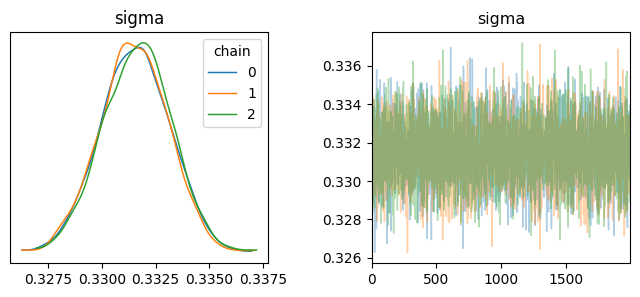

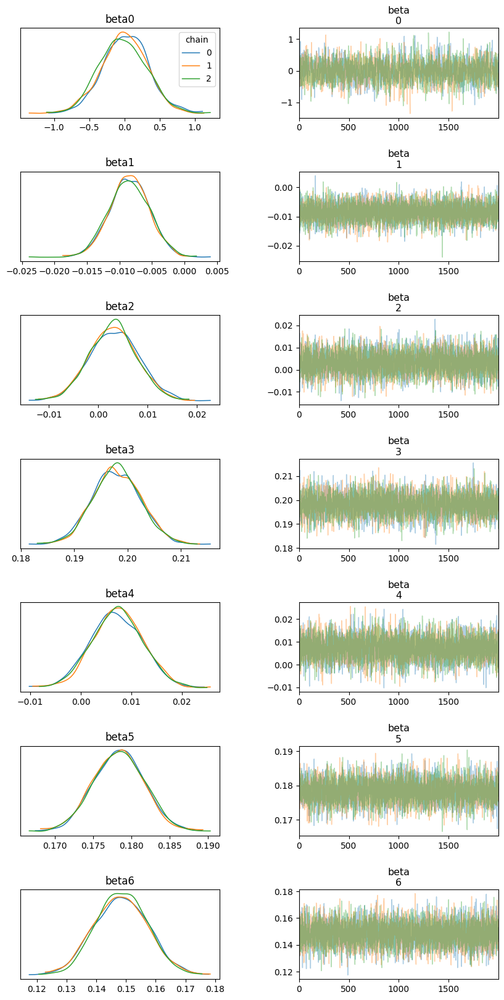

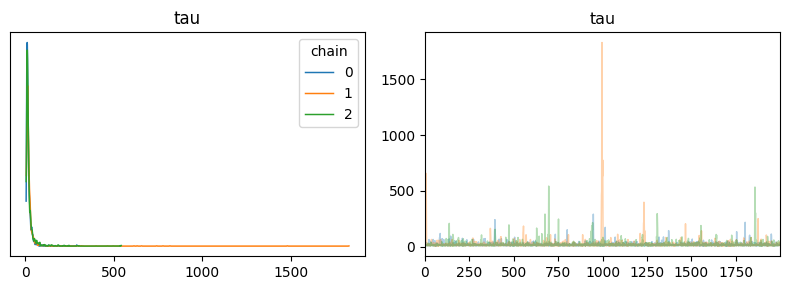

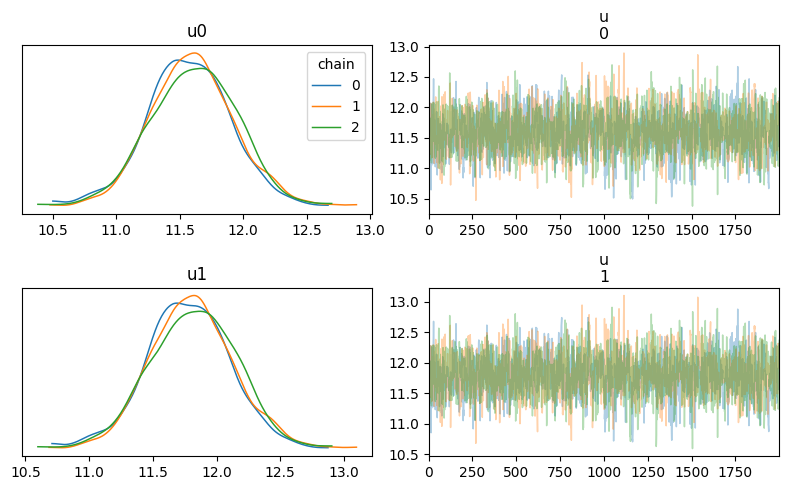

In [71]:
# Check MCMC convergence
import arviz

# sigma
traceplot = arviz.plot_trace(fit5, var_names=['sigma'], compact = False, figsize = (8, 3), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"sigma")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values
plt.show()

# beta
traceplot = arviz.plot_trace(fit5, var_names=['beta'], compact = False, figsize = (10, 20), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"beta{i}")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values
plt.show()

# sigma
traceplot = arviz.plot_trace(fit5, var_names=['tau'], compact = False, figsize = (8, 3), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"tau")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values
plt.tight_layout()
plt.show()

# beta
traceplot = arviz.plot_trace(fit5, var_names=['u'], compact = False, figsize = (8, 5), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"u{i}")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values
plt.tight_layout()
plt.show()

#### Model checking; Predictive Posterior check

In [72]:
# Extract samples
extracted_samples = fit5.extract()

# Extract Y_mean and posterior mean of Y_mean
Y_mean = extracted_samples['Y_mean']
Y_mean_mean = np.mean(Y_mean, axis=0)
Y_mean_cred = np.quantile(Y_mean, [0.05, 0.95], axis=0)

# Extract Y_pred and posterior mean of Y_pred
Y_pred = extracted_samples['Y_pred']
Y_pred_mean = np.mean(Y_pred, axis=0)
Y_pred_cred = np.quantile(Y_pred, [0.05, 0.95], axis=0)

#### Test quantity 1 - Residual test quantity

Residual test statistics is  
$$
T(y, \theta) = \frac{1}{n_{sims}} \int_{n=1}^{N}|| y_i - X_i\beta_i ||^2
$$

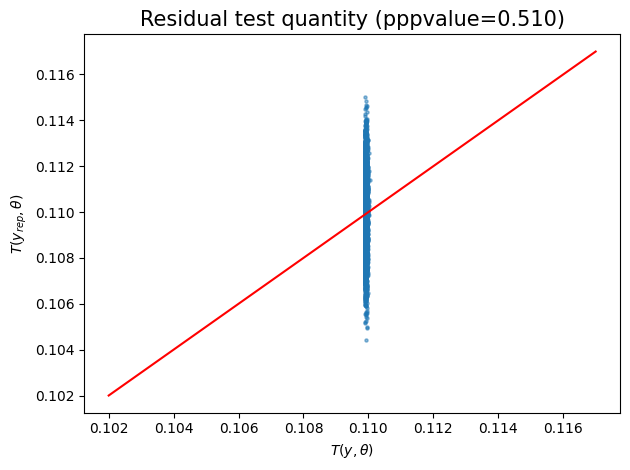

In [86]:
# predictive poserior check - residual test quantity
test_stat_obs = np.mean(np.power((y.values.reshape(1, -1) - Y_mean), 2), axis=1)
test_stat_rep = np.mean(np.power((Y_pred - Y_mean), 2), axis=1)
pvalue = np.mean((test_stat_rep > test_stat_obs))

plt.scatter(test_stat_obs, test_stat_rep, alpha=0.5, s=5)
plt.plot(np.linspace(0.102, 0.117, num=100),
         np.linspace(0.102, 0.117, num=100),
         color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y_{{rep}}, \\theta) $')

plt.title(f'Residual test quantity (pppvalue={pvalue :.3f})', fontsize=15)
plt.tight_layout()
plt.show()

#### Test quantity 2 - Mean test quantity

Mean test statistics is  
$$
T(y, \theta) = \frac{1}{N} \int_{n=1}^{N} y_i
$$

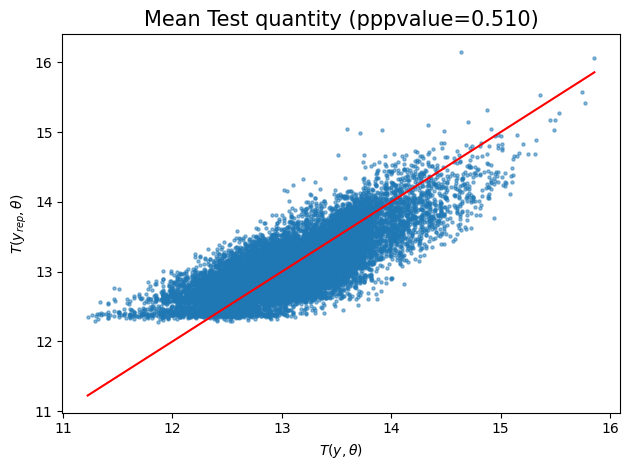

In [74]:
# Predictive posterior check - mean comparison
pvalue = np.mean(np.mean(extracted_samples['Y_pred'], axis=1) > np.mean(y))

plt.scatter(y, Y_pred_mean, alpha=0.5, s=5)
plt.plot(np.linspace(min(y), max(y), num=100), np.linspace(min(y), max(y), num=100), color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y_{{rep}}, \\theta) $')
plt.title(f'Mean Test quantity (pppvalue={pvalue :.3f})', fontsize=15)
plt.tight_layout()
plt.show()

#### Test quantity 3 - The square root of the average of the 2 riverside residuals

The test statistics is  
$$
T(y, \theta) = \sqrt{\frac{1}{J}\sum^{J}_{j=1} \left( \frac{1}{n_j}\sum_{i \in group_j}(y_i - X_i \beta) \right)^2}

$$

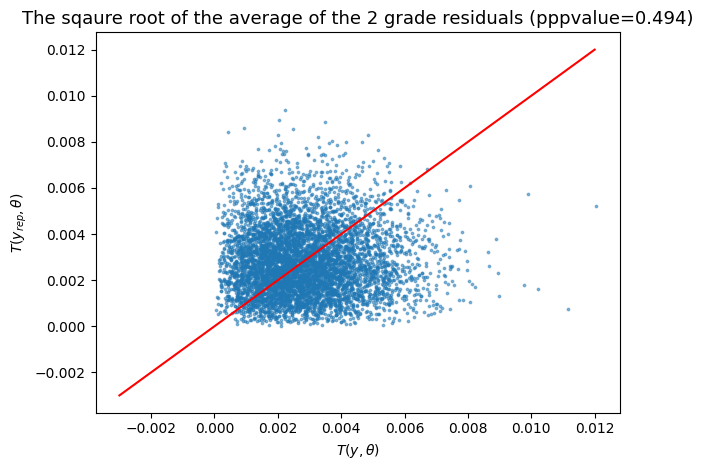

In [80]:
# Predictive posterior check - The square root of the average of the 2 grade residuals
# test statistics of replicated
test_rep = np.zeros((Y_pred.shape[0], L))
for i in range(L):
    indicator = (group == (i+1))
    test_rep[:, i] = np.mean((Y_pred - Y_mean)[:, indicator], axis=1)
test_rep = np.power(np.mean(np.power(test_rep, 2), axis=1), 1/2)

# test statistics of observed
test_obs = np.zeros((Y_pred.shape[0], L))
for i in range(L):
    indicator = (group == (i+1))
    test_obs[:, i] = np.mean((y.values.reshape(1, -1) - Y_mean)[:, indicator], axis=1)
test_obs = np.power(np.mean(np.power(test_obs, 2), axis=1), 1/2)

# pppvalue
pvalue = np.mean(test_rep > test_obs)

# plot
plt.scatter(test_obs, test_rep, alpha=0.5, s=3)
plt.plot(np.linspace(-0.003, 0.012, num=100),
         np.linspace(-0.003, 0.012, num=100), color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y_{{rep}}, \\theta) $')
plt.title(f'The sqaure root of the average of the 2 grade residuals (pppvalue={pvalue :.3f})', fontsize=13)
plt.tight_layout()
plt.show()

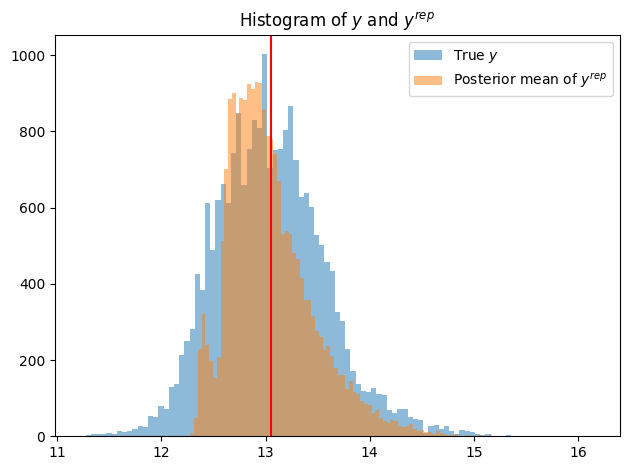

In [76]:
# variance가 너무 크다
plt.hist(y, bins='auto', alpha=0.5, label='True $ y $')
plt.hist(Y_pred_mean, bins='auto', alpha=0.5, label=f'Posterior mean of $ y^{{rep}} $')
plt.axvline(x=np.mean(y), color='red')

plt.title(f'Histogram of $ y $ and $ y^{{rep}} $')
plt.legend()
plt.tight_layout()
plt.show()

In [89]:
posterior_mean_fit5 = Y_pred_mean.copy()
# posterior_mean_fit5.shape
np.savetxt('posterior_mean_fit5.csv', posterior_mean_fit5, delimiter=",")

#### Prediction

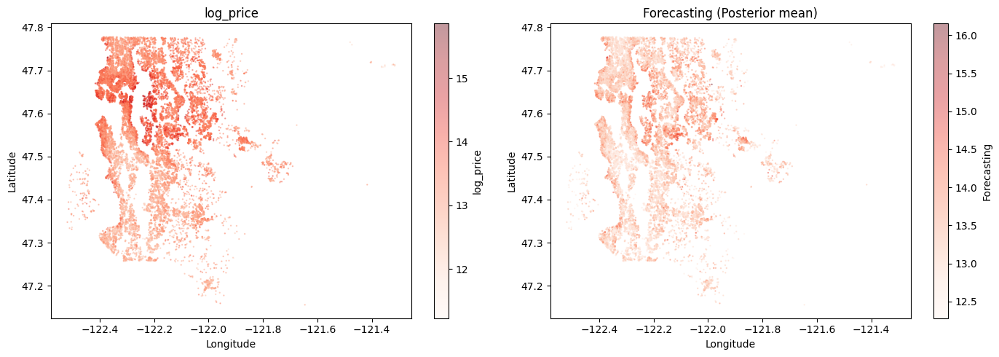

In [96]:
plt.figure(figsize=(14,5))

plt.subplot(1, 2, 1)
plt.scatter(x=df['long'], y=df['lat'], c=df['log_price'], cmap='Reds', alpha=0.4, s=0.5)
plt.colorbar(label='log_price')
plt.title('log_price')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.subplot(1, 2, 2)
plt.scatter(x=df['long'], y=df['lat'], c=posterior_mean_fit5, cmap='Reds', alpha=0.4, s=0.5)
plt.colorbar(label='Forecasting')
plt.title('Forecasting (Posterior mean)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.tight_layout()
plt.show()

# view=='0'인 것들은 안보임

----

### Model 2 - Simple Linear model (Full dataset)

$$
\begin{aligned}
\text{Likelihood} \quad &y = X \beta + \epsilon, \quad \epsilon \sim N(0, \sigma^2 I_n)\\
\text{Prior} \quad &p(\beta, \sigma^2) \propto \sigma^{-2}
\end{aligned}
$$

#### Model Compile

In [ ]:
# Linear regression with non-informative prior
model_reg1 = """ 
data {              
  int<lower=0> n;   // number of data items
  int<lower=0> p;   // number of predictors
  matrix[n,p] X;    // predictor matrix
  vector[n] y;      // outcome vector
}
parameters {            
  vector[p] beta;       // coefficients for predictors with intercept
  real<lower=0> sigma;  // error scale
}
model { 
  y ~ normal(X * beta, sqrt(sigma));  //likelihood
  target += -2*log(sigma);		// noninformative prior for beta, sigma^2 (log-density)
}
generated quantities{
  real Y_mean[n];
  real Y_pred[n];
  for(i in 1:n){
    // Posterior parameter distribution of the mean
    Y_mean[i] = X[i] * beta;
    // Posterior predictive distribution
    Y_pred[i] = normal_rng(Y_mean[i], sigma);
}
}
""" 

sm = pystan.StanModel(model_code = model_reg1)

In file included from /var/folders/4y/7tgg1kws66z0gg7gpxn2pdd40000gn/T/pystan_a3yjykoc/stanfit4anon_model_9568ea26533943e7b61652c68b4f8dc1_532240356704276108.cpp:836:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/arrayobject.h:5:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/ndarrayobject.h:12:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/ndarraytypes.h:1940:
/Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/npy_1_7_deprecated_api.h:17:2: warning: "Using deprecated NumPy API, disable it with "          "#define NPY_NO_DEPRECATED_API NPY_1_7_API_VERSION" [-W#warnings]
#warning "Using deprecated NumPy API, disable it with " \
 ^
In file included from /var/folders/4y/7tgg1kws66z0gg7gpxn2pdd40000gn/T/pystan_a3yjykoc/stanfit4anon_model_9568ea26533943e7b61652c68b4f8dc1_532240356704276

#### Fit the model

In [111]:
import statsmodels.tools as sm_tools

y = df2_transformed['log_price']
X = df2_transformed.drop(columns=['log_price']).copy()
X = sm_tools.add_constant(X)  # add intercept term

X.head()

,const,bedrooms,bathrooms,sqft_living,floors,new_grade,riverside,nearby
0,1.000,3,1.000,-0.980,1.000,7,0,1
1,1.000,3,2.250,0.534,2.000,7,0,0
2,1.000,2,1.000,-1.426,1.000,6,0,0
3,1.000,4,3.000,-0.131,1.000,7,0,1
4,1.000,3,2.000,-0.435,1.000,8,0,1


In [112]:
n = X.shape[0]
p = X.shape[1]
print(n, p)

21613 8


In [113]:
fit6 = sm.sampling(
  data={'n': n, 'p': p, 'X': X, 'y': y},    # named list of data
  chains = 3,             # number of Markov chains
  warmup = 1500,          # number of warmup iterations per chain
  iter = 3000,            # total number of iterations per chain
  # control = list(adapt_delta=0.99),  # this may help
  # control = list(max_treedepth=16),  # this may help
  n_jobs = 1               # number of cores (could use one per chain)
)


Gradient evaluation took 0.002358 seconds
1000 transitions using 10 leapfrog steps per transition would take 23.58 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 3000 [  0%]  (Warmup)
Iteration:  300 / 3000 [ 10%]  (Warmup)
Iteration:  600 / 3000 [ 20%]  (Warmup)
Iteration:  900 / 3000 [ 30%]  (Warmup)
Iteration: 1200 / 3000 [ 40%]  (Warmup)
Iteration: 1500 / 3000 [ 50%]  (Warmup)
Iteration: 1501 / 3000 [ 50%]  (Sampling)
Iteration: 1800 / 3000 [ 60%]  (Sampling)
Iteration: 2100 / 3000 [ 70%]  (Sampling)
Iteration: 2400 / 3000 [ 80%]  (Sampling)
Iteration: 2700 / 3000 [ 90%]  (Sampling)
Iteration: 3000 / 3000 [100%]  (Sampling)

 Elapsed Time: 87.8742 seconds (Warm-up)
               76.9029 seconds (Sampling)
               164.777 seconds (Total)


Gradient evaluation took 0.000704 seconds
1000 transitions using 10 leapfrog steps per transition would take 7.04 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 3000 [  0%]  (Warmup)
Iteration:  300

To run all diagnostics call pystan.check_hmc_diagnostics(fit)


Gradient evaluation took 0.001188 seconds
1000 transitions using 10 leapfrog steps per transition would take 11.88 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 3000 [  0%]  (Warmup)
Iteration:  300 / 3000 [ 10%]  (Warmup)
Iteration:  600 / 3000 [ 20%]  (Warmup)
Iteration:  900 / 3000 [ 30%]  (Warmup)
Iteration: 1200 / 3000 [ 40%]  (Warmup)
Iteration: 1500 / 3000 [ 50%]  (Warmup)
Iteration: 1501 / 3000 [ 50%]  (Sampling)
Iteration: 1800 / 3000 [ 60%]  (Sampling)
Iteration: 2100 / 3000 [ 70%]  (Sampling)
Iteration: 2400 / 3000 [ 80%]  (Sampling)
Iteration: 2700 / 3000 [ 90%]  (Sampling)
Iteration: 3000 / 3000 [100%]  (Sampling)

 Elapsed Time: 158.059 seconds (Warm-up)
               78.4842 seconds (Sampling)
               236.543 seconds (Total)



In [114]:
print(fit6)

Inference for Stan model: anon_model_9568ea26533943e7b61652c68b4f8dc1.
3 chains, each with iter=3000; warmup=1500; thin=1; 
post-warmup draws per chain=1500, total post-warmup draws=4500.

                 mean se_mean      sd    2.5%     25%     50%     75%   97.5%  n_eff   Rhat
beta[1]         11.59  7.1e-4    0.03   11.54   11.57   11.59   11.61   11.65   1546    1.0
beta[2]       -8.5e-3  5.3e-5  3.1e-3   -0.01   -0.01 -8.4e-3 -6.4e-3 -2.5e-3   3319    1.0
beta[3]        2.9e-3  8.2e-5  4.9e-3 -6.8e-3 -4.5e-4  2.9e-3  6.1e-3    0.01   3594    1.0
beta[4]           0.2  1.1e-4  4.5e-3    0.19     0.2     0.2     0.2    0.21   1745    1.0
beta[5]        7.2e-3  7.7e-5  5.0e-3 -2.6e-3  3.8e-3  7.2e-3    0.01    0.02   4208    1.0
beta[6]          0.18  7.6e-5  3.4e-3    0.17    0.18    0.18    0.18    0.19   1979    1.0
beta[7]          0.15  1.5e-4  8.9e-3    0.13    0.14    0.15    0.15    0.17   3613    1.0
beta[8]          0.21  7.7e-5  4.9e-3     0.2     0.2    0.21    0.21    0.

#### Check the MCMC Convergence

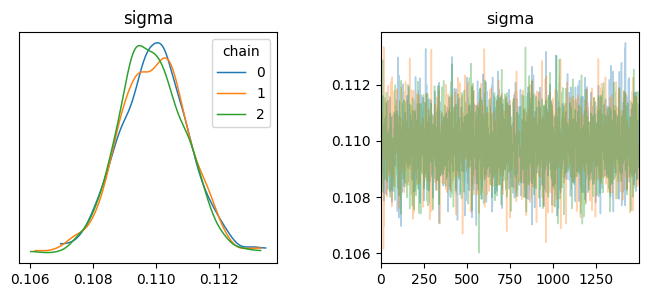

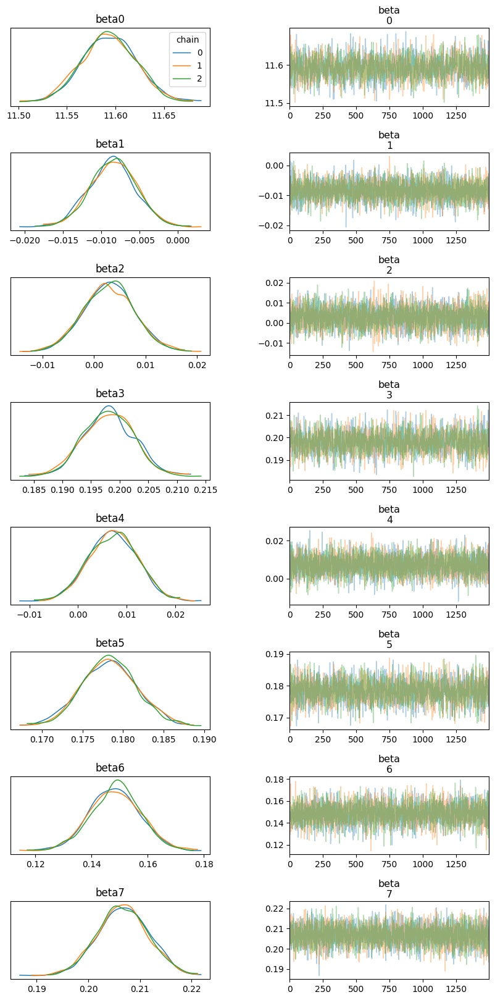

In [115]:
# Check MCMC convergence
import arviz

traceplot = arviz.plot_trace(fit6, var_names=['sigma'], compact = False, figsize = (8, 3), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"sigma")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values

plt.show()

traceplot = arviz.plot_trace(fit6, var_names=['beta'], compact = False, figsize = (10, 20), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"beta{i}")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values

plt.show()

#### Model checking; Predictive Posterior check

In [116]:
# Extract samples
extracted_samples = fit6.extract()

# Extract Y_mean and posterior mean of Y_mean
Y_mean = extracted_samples['Y_mean']
Y_mean_mean = np.mean(Y_mean, axis=0)
Y_mean_cred = np.quantile(Y_mean, [0.05, 0.95], axis=0)

# Extract Y_pred and posterior mean of Y_pred
Y_pred = extracted_samples['Y_pred']
Y_pred_mean = np.mean(Y_pred, axis=0)
Y_pred_cred = np.quantile(Y_pred, [0.05, 0.95], axis=0)

#### Test quantity 1 - Residual test quantity

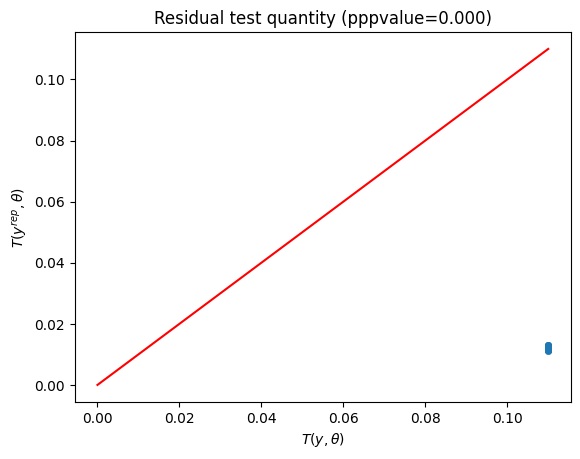

In [143]:
# 1. predictive poserior check - residual test quantity
test_stat_obs = np.mean(np.power((y.values.reshape(1, -1) - Y_mean), 2), axis=1)
test_stat_rep = np.mean(np.power((Y_pred - Y_mean), 2), axis=1)
pvalue = np.mean((test_stat_rep > test_stat_obs))

plt.scatter(test_stat_obs, test_stat_rep, alpha=0.5, s=16)
plt.plot(np.linspace(0.0, 0.11, num=100),
         np.linspace(0.0, 0.11, num=100),
         color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y^{{rep}}, \\theta) $')
plt.title(f'Residual test quantity (pppvalue={pvalue :.3f})')
plt.show()

#### Test quantity 2 - Mean test quantity

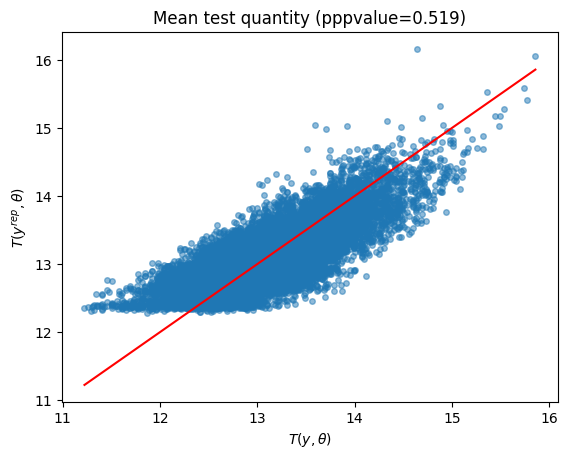

In [118]:
# 2. Predictive posterior check - mean comparison
# 얘는 0.5랑 가까움....!
pvalue = np.mean(np.mean(extracted_samples['Y_pred'], axis=1) > np.mean(y))

plt.scatter(y, Y_pred_mean, alpha=0.5, s=16)
plt.plot(np.linspace(min(y), max(y), num=100), np.linspace(min(y), max(y), num=100), color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y^{{rep}}, \\theta) $')
plt.title(f'Mean test quantity (pppvalue={pvalue :.3f})')
plt.show()

#### Test quantity 3 - The square root of the average of the 2 riverside residuals

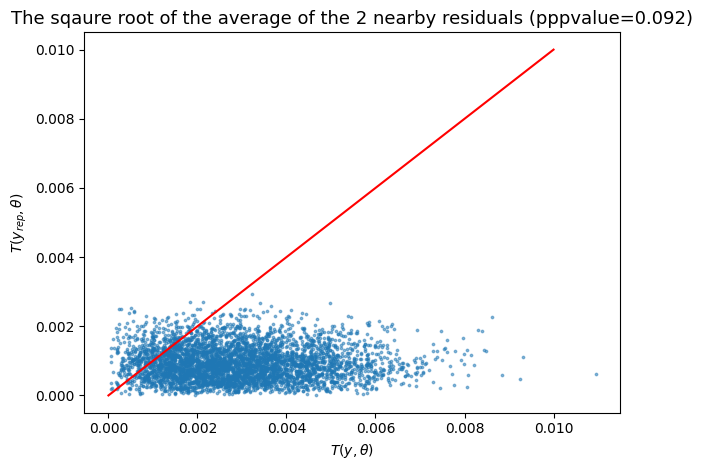

In [134]:
group = df2_transformed['nearby'] + 1
group = group.astype(int)
L = 2

# Predictive posterior check - The square root of the average of the 6 grade residuals
test_rep = np.zeros((Y_pred.shape[0], L))
for i in range(L):
    indicator = (group == (i+1))
    test_rep[:, i] = np.mean((Y_pred - Y_mean)[:, indicator], axis=1)
test_rep = np.power(np.mean(np.power(test_rep, 2), axis=1), 1/2)

test_obs = np.zeros((Y_pred.shape[0], L))
for i in range(L):
    indicator = (group == (i+1))
    test_obs[:, i] = np.mean((y.values.reshape(1, -1) - Y_mean)[:, indicator], axis=1)
test_obs = np.power(np.mean(np.power(test_obs, 2), axis=1), 1/2)

# pppvalue
pvalue = np.mean(test_rep > test_obs)

plt.scatter(test_obs, test_rep, alpha=0.5, s=3)
plt.plot(np.linspace(0.0, 0.01, num=100),
         np.linspace(0.0, 0.01, num=100), color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y_{{rep}}, \\theta) $')
plt.title(f'The sqaure root of the average of the 2 nearby residuals (pppvalue={pvalue :.3f})', fontsize=13)
plt.tight_layout()
plt.show()

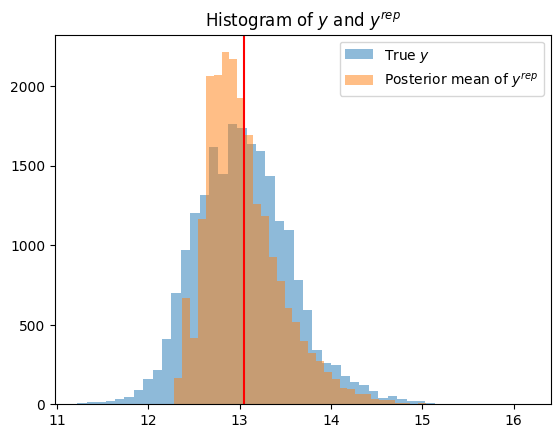

In [140]:
# variance가 너무 크다
plt.hist(y, bins=45, alpha=0.5, label='True $ y $')
plt.hist(Y_pred_mean, bins=45, alpha=0.5, label=f'Posterior mean of $ y^{{rep}} $')
plt.axvline(x=np.mean(y), color='red')
plt.title(f'Histogram of $ y $ and $ y^{{rep}} $')
plt.legend()
plt.show()

---

### Model 13 - Hierarchical model (sampling)

- new_grade random effect

#### Random sampling

In [ ]:
import random

random.seed(1)

df3 = df2_transformed.sample(n=1000, random_state=1).sort_index() # randomly sample 1000 houses (records)

$$
\begin{aligned}
\text{Likelihood} \quad &y \sim N(X_1 \beta_{fix} + X_2 \beta_{ran}, \sigma^2 I_n), \quad \beta_{ran} \sim N_J(0_J, \tau^2 I_J)\\
\text{Prior} \quad &\sigma^2 \sim \text{Inv-gamma}(0.3, 0.5) \\
&\beta_{fix} \sim N(0, 1000 I_p) \\
&\tau^2 \sim \text{Inv-gamma}(0.01, 0.01)
\end{aligned}
$$

$$
\begin{aligned}
X_2 = 
\begin{pmatrix} 
1_{n_1} & 0_{n_1} & 0_{n_1} & 0_{n_1} & 0_{n_1} & 0_{n_1}\\
0_{n_2} & 1_{n_2} & 0_{n_2} & 0_{n_2} & 0_{n_2} & 0_{n_2}\\
0_{n_3} & 0_{n_3} & 1_{n_3} & 0_{n_3} & 0_{n_3} & 0_{n_3}\\
0_{n_4} & 0_{n_4} & 0_{n_4} & 1_{n_4} & 0_{n_4} & 0_{n_4}\\
0_{n_5} & 0_{n_5} & 0_{n_5} & 0_{n_5} & 1_{n_5} & 0_{n_5}\\
0_{n_6} & 0_{n_6} & 0_{n_6} & 0_{n_6} & 0_{n_6} & 1_{n_6}\\
\end{pmatrix}
\end{aligned}
$$

$$
\begin{aligned}
\beta_{ran} =
\begin{pmatrix}
\beta_{ran, 1} \\ \vdots \\ \beta_{ran, J}
\end{pmatrix}, \quad
\beta_{ran, i} \sim N(0, \tau^2), \quad
i = 1, \dots, 6
\end{aligned}
$$

#### Model Compile

In [ ]:
# Mixed model with non-informative prior
model_reg2 = """ 
data {              
  int<lower=0> N;    // number of data items
  int<lower=0> p;    // number of predictors
  real y[N];          // response
  row_vector[p] X[N];  // predictor

  int<lower=1> L;    // num of group 6
  int<lower=1,upper=L> ll[N];  // group indicator
}
parameters {  
  real<lower=0> tau1;  // var of random effect beta_ran          
  real<lower=0> tau2;  // var of epsilon
  vector[p] beta;      // fixed effect
  real u[L];           // mixed effect
}
transformed parameters {
  real tau;    // var for random effect
  real sigma;  // var for error term
  real m[N];
  for (i in 1:N){
    m[i] = X[i] * beta + u[ll[i]];
  }
  sigma = 1 / sqrt(tau2);
  tau = 1 / sqrt(tau1);
}

model {
  // priors for beta and sigma^2
  for (i in 1:p){
    beta[i] ~ normal(0.0, sigma);  // noninformative prior
  }
  tau2 ~ gamma(0.3, 0.5);
  tau1 ~ gamma(0.01, 0.01);
  for (l in 1:L){
    u[l] ~ normal(0, tau);
  }
  // likelihood
  for (n in 1:N){
   y[n] ~ normal(m[n], sigma); 
  }
}

generated quantities{
  real Y_mean[N];
  real Y_pred[N];
  for(i in 1:N){
    // Posterior parameter distribution of the mean
    Y_mean[i] = X[i] * beta + u[ll[i]];
    // Posterior predictive distribution
    Y_pred[i] = normal_rng(Y_mean[i], sigma);
  }
}
""" 

sm = pystan.StanModel(model_code = model_reg2)

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_c838a07761e52c7f6c1c6d244ff79c70 NOW.
In file included from /var/folders/4y/7tgg1kws66z0gg7gpxn2pdd40000gn/T/pystan_wqczmm20/stanfit4anon_model_c838a07761e52c7f6c1c6d244ff79c70_721975790142691710.cpp:836:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/arrayobject.h:5:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/ndarrayobject.h:12:
In file included from /Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/ndarraytypes.h:1940:
/Users/juyeon/Library/Python/3.9/lib/python/site-packages/numpy/core/include/numpy/npy_1_7_deprecated_api.h:17:2: warning: "Using deprecated NumPy API, disable it with "          "#define NPY_NO_DEPRECATED_API NPY_1_7_API_VERSION" [-W#warnings]
#warning "Using deprecated NumPy API, disable it with " \
 ^
In file included from /var/folders/4y/7tgg1kws66z0gg7gpxn2pd

#### Fit the model

In [ ]:
import statsmodels.tools as sm_tools

y = df3['log_price']
# X = df3.drop(columns=['log_price']).copy()

X = df3.drop(columns=['log_price', 'new_grade']).copy()
X = sm_tools.add_constant(X)  # add intercept term
group = df3['new_grade'] - 5
print(np.unique(group))
X.head()

[1 2 3 4 5 6]


,const,bedrooms,bathrooms,sqft_living,floors,waterfront,sqft_living15,riverside,nearby
13,1.000,3,1.750,-0.773,1.000,0,1370,0,0.000
19,1.000,3,1.000,-0.904,1.000,0,1280,0,0.000
33,1.000,3,1.000,-1.078,1.500,0,1570,0,1.000
44,1.000,3,1.000,-0.871,1.000,0,1340,0,0.000
72,1.000,4,2.000,0.730,1.500,0,1510,0,1.000


In [ ]:
n = X.shape[0]
p = X.shape[1]
L = len(np.unique(group))  # num of groups
print(n, p, L)
G = group.values  # Group indicator

1000 9 6


In [ ]:
fit2 = sm.sampling(
  data={'N': n, 'p': p, 'X': X, 'y': y, 'L': L, 'll': G},    # named list of data
  chains = 3,             # number of Markov chains
  warmup = 2000,          # number of warmup iterations per chain
  iter = 4000,            # total number of iterations per chain
  # control = list(adapt_delta=0.99),  # this may help
  # control = list(max_treedepth=16),  # this may help
  n_jobs = 1               # number of cores (could use one per chain), 
)


Gradient evaluation took 0.000169 seconds
1000 transitions using 10 leapfrog steps per transition would take 1.69 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 4000 [  0%]  (Warmup)
Iteration:  400 / 4000 [ 10%]  (Warmup)
Iteration:  800 / 4000 [ 20%]  (Warmup)
Iteration: 1200 / 4000 [ 30%]  (Warmup)
Iteration: 1600 / 4000 [ 40%]  (Warmup)
Iteration: 2000 / 4000 [ 50%]  (Warmup)
Iteration: 2001 / 4000 [ 50%]  (Sampling)
Iteration: 2400 / 4000 [ 60%]  (Sampling)
Iteration: 2800 / 4000 [ 70%]  (Sampling)
Iteration: 3200 / 4000 [ 80%]  (Sampling)
Iteration: 3600 / 4000 [ 90%]  (Sampling)
Iteration: 4000 / 4000 [100%]  (Sampling)

 Elapsed Time: 163.437 seconds (Warm-up)
               181.737 seconds (Sampling)
               345.175 seconds (Total)



To run all diagnostics call pystan.check_hmc_diagnostics(fit)



Gradient evaluation took 0.000109 seconds
1000 transitions using 10 leapfrog steps per transition would take 1.09 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 4000 [  0%]  (Warmup)
Iteration:  400 / 4000 [ 10%]  (Warmup)
Iteration:  800 / 4000 [ 20%]  (Warmup)
Iteration: 1200 / 4000 [ 30%]  (Warmup)
Iteration: 1600 / 4000 [ 40%]  (Warmup)
Iteration: 2000 / 4000 [ 50%]  (Warmup)
Iteration: 2001 / 4000 [ 50%]  (Sampling)
Iteration: 2400 / 4000 [ 60%]  (Sampling)
Iteration: 2800 / 4000 [ 70%]  (Sampling)
Iteration: 3200 / 4000 [ 80%]  (Sampling)
Iteration: 3600 / 4000 [ 90%]  (Sampling)
Iteration: 4000 / 4000 [100%]  (Sampling)

 Elapsed Time: 161.789 seconds (Warm-up)
               181.142 seconds (Sampling)
               342.932 seconds (Total)


Gradient evaluation took 0.000108 seconds
1000 transitions using 10 leapfrog steps per transition would take 1.08 seconds.
Adjust your expectations accordingly!


Iteration:    1 / 4000 [  0%]  (Warmup)
Iteration:  400 

In [ ]:
X.columns

Index(['const', 'bedrooms', 'bathrooms', 'sqft_living', 'floors', 'waterfront',
       'sqft_living15', 'riverside', 'nearby'],
      dtype='object')

In [ ]:
print(fit2)

Inference for Stan model: anon_model_c838a07761e52c7f6c1c6d244ff79c70.
3 chains, each with iter=4000; warmup=2000; thin=1; 
post-warmup draws per chain=2000, total post-warmup draws=6000.

                mean se_mean     sd    2.5%    25%     50%    75%   97.5%  n_eff   Rhat
tau1          5.8e-3  5.4e-5 3.3e-3  1.2e-3 3.4e-3  5.2e-3 7.5e-3    0.01   3818    1.0
tau2            9.98  7.3e-3   0.44    9.14   9.68    9.97  10.28   10.85   3621    1.0
beta[1]         0.06    0.02   0.31   -0.55  -0.15    0.06   0.26    0.69    400    1.0
beta[2]        -0.03  2.6e-4   0.01   -0.06  -0.04   -0.03  -0.02 -5.0e-3   2835    1.0
beta[3]      -1.5e-4  4.5e-4   0.02   -0.04  -0.01 -3.3e-4   0.01    0.04   2411    1.0
beta[4]         0.19  4.7e-4   0.02    0.15   0.18    0.19   0.21    0.24   2339    1.0
beta[5]      -2.4e-3  4.1e-4   0.02   -0.05  -0.02 -2.4e-3   0.01    0.04   2938    1.0
beta[6]         0.47  2.2e-3   0.13    0.23   0.39    0.48   0.56    0.72   3250    1.0
beta[7]       2.1e-

#### Check the MCMC Convergence

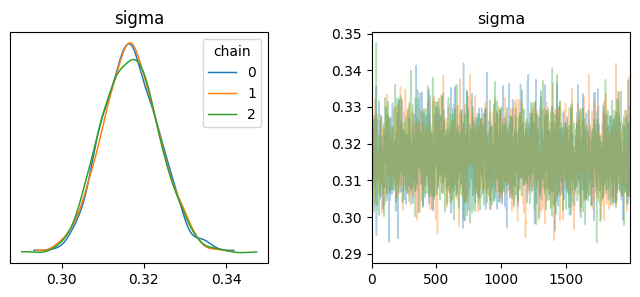

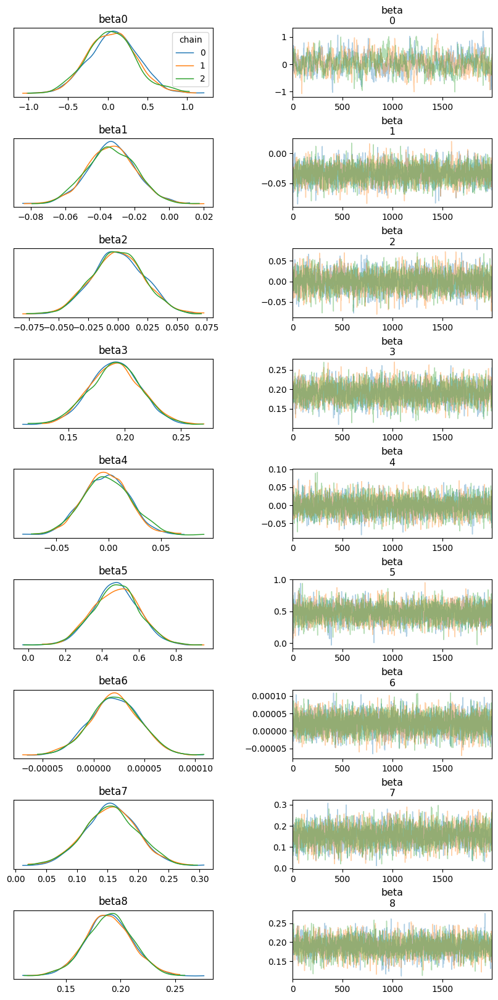

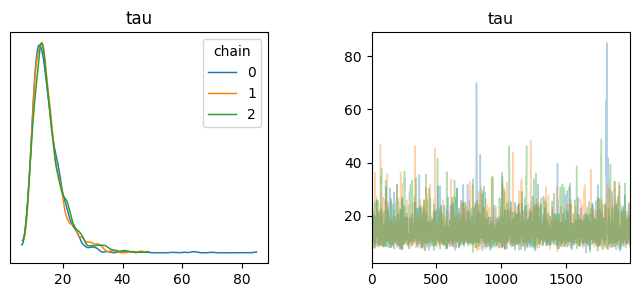

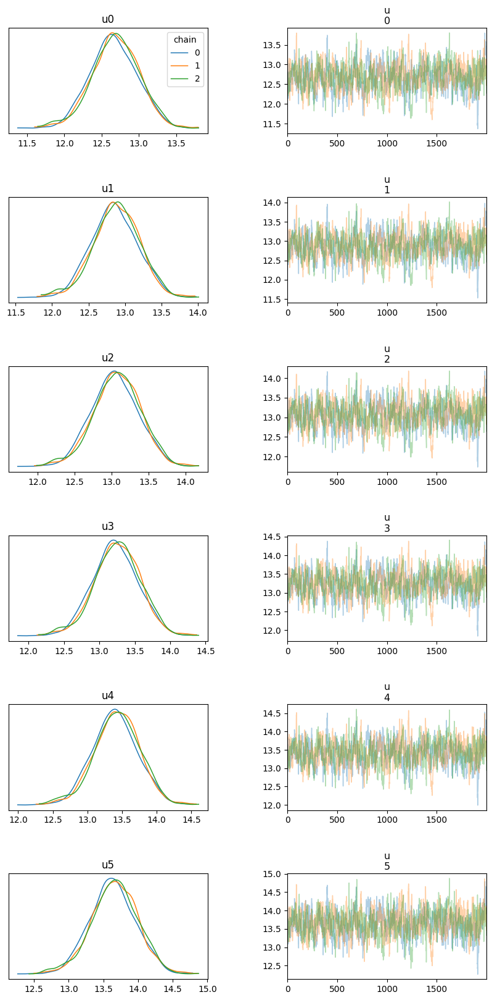

In [ ]:
# Check MCMC convergence
import arviz

# sigma
traceplot = arviz.plot_trace(fit2, var_names=['sigma'], compact = False, figsize = (8, 3), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"sigma")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values
plt.show()

# beta
traceplot = arviz.plot_trace(fit2, var_names=['beta'], compact = False, figsize = (10, 20), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"beta{i}")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values
plt.show()

# sigma
traceplot = arviz.plot_trace(fit2, var_names=['tau'], compact = False, figsize = (8, 3), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"tau")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values
plt.show()

# beta
traceplot = arviz.plot_trace(fit2, var_names=['u'], compact = False, figsize = (10, 20), legend=True) # compace = True leads to all beta values overlapped.
for i in range(len(traceplot)):
    traceplot[i][0].set_title(f"u{i}")
# Adjust the space between subplots
plt.subplots_adjust(wspace=0.4, hspace=0.6) # you can modify these values
plt.show()

#### Model checking; Predictive Posterior check

In [ ]:
# Extract samples
extracted_samples = fit2.extract()

# Extract Y_mean and posterior mean of Y_mean
Y_mean = extracted_samples['Y_mean']
Y_mean_mean = np.mean(Y_mean, axis=0)
Y_mean_cred = np.quantile(Y_mean, [0.05, 0.95], axis=0)

# Extract Y_pred and posterior mean of Y_pred
Y_pred = extracted_samples['Y_pred']
Y_pred_mean = np.mean(Y_pred, axis=0)
Y_pred_cred = np.quantile(Y_pred, [0.05, 0.95], axis=0)

#### Test quantity 1 - Residual test quantity

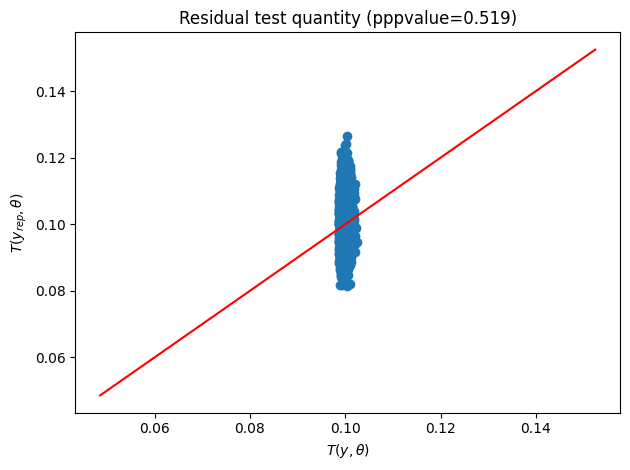

In [ ]:
# predictive poserior check - residual test quantity
test_stat_obs = np.mean(np.power((y.values.reshape(1, -1) - Y_mean), 2), axis=1)
test_stat_rep = np.mean(np.power((Y_pred - Y_mean), 2), axis=1)
pvalue = np.mean((test_stat_rep > test_stat_obs))

plt.scatter(test_stat_obs, test_stat_rep)
plt.plot(np.linspace(min(test_stat_obs)-0.05, max(test_stat_obs)+0.05, num=100),
         np.linspace(min(test_stat_obs)-0.05, max(test_stat_obs)+0.05, num=100),
         color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y_{{rep}}, \\theta) $')
plt.title(f'Residual test quantity (pppvalue={pvalue :.3f})')
plt.tight_layout()
plt.show()

#### Test quantity 2 - Mean test quantity

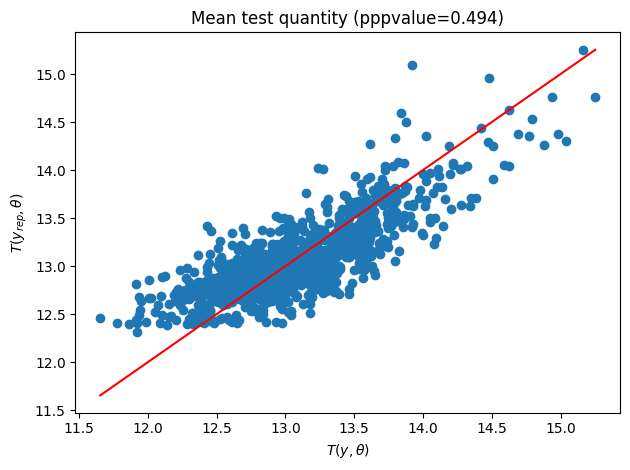

In [ ]:
# Predictive posterior check - mean comparison
# 얘는 0.5랑 가까움....!
pvalue = np.mean(np.mean(extracted_samples['Y_pred'], axis=1) > np.mean(y))

plt.scatter(y, Y_pred_mean)
plt.plot(np.linspace(min(y), max(y), num=100), np.linspace(min(y), max(y), num=100), color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y_{{rep}}, \\theta) $')
plt.title(f'Mean test quantity (pppvalue={pvalue :.3f})')
plt.tight_layout()
plt.show()

#### Test quantity 3 - The square root of the average of the 6 grade residuals

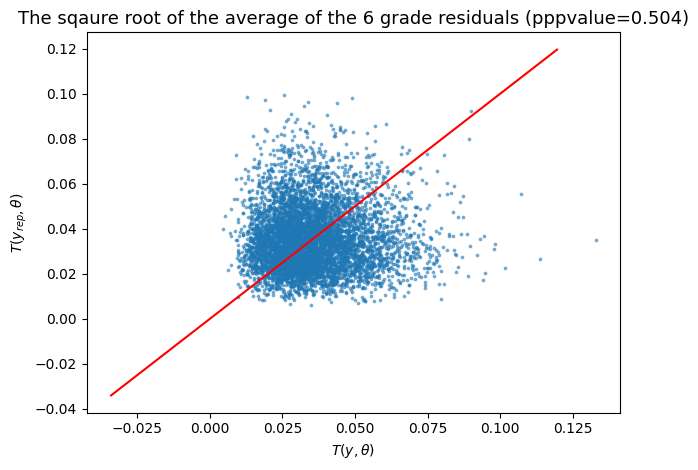

In [ ]:
# Predictive posterior check - The square root of the average of the 6 grade residuals
test_rep = np.zeros((Y_pred.shape[0], 6))
for i in range(6):
    indicator = (group == (i+1))
    test_rep[:, i] = np.mean((Y_pred - Y_mean)[:, indicator], axis=1)

test_rep = np.power(np.mean(np.power(test_rep, 2), axis=1), 1/2)

test_obs = np.zeros((Y_pred.shape[0], 6))
for i in range(6):
    indicator = (group == (i+1))
    test_obs[:, i] = np.mean((y.values.reshape(1, -1) - Y_mean)[:, indicator], axis=1)

test_obs = np.power(np.mean(np.power(test_obs, 2), axis=1), 1/2)

pvalue = np.mean(test_rep > test_obs)


plt.scatter(test_obs, test_rep, alpha=0.5, s=3)
plt.plot(np.linspace(min(test_rep)-0.04, max(test_rep)+0.02, num=100),
         np.linspace(min(test_rep)-0.04, max(test_rep)+0.02, num=100), color='red')
plt.xlabel(f'$ T(y, \\theta) $')
plt.ylabel(f'$ T(y_{{rep}}, \\theta) $')
plt.title(f'The sqaure root of the average of the 6 grade residuals (pppvalue={pvalue :.3f})', fontsize=13)
plt.tight_layout()
plt.show()

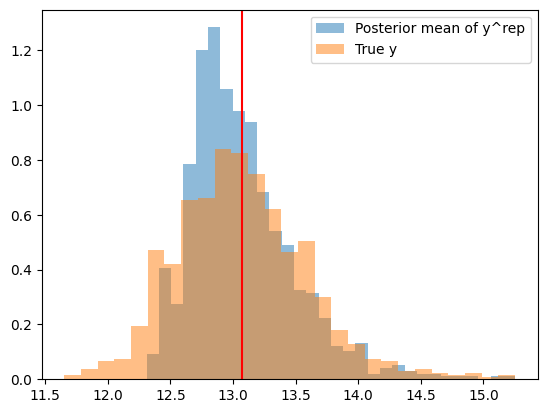

In [ ]:
# variance가 너무 크다
plt.hist(Y_pred_mean, bins='auto', alpha=0.5, label='Posterior mean of y^rep', density=True)
plt.hist(y, bins='auto', alpha=0.5, label='True y', density=True)
plt.axvline(x=np.mean(y), color='red')
# plt.xlim(11, 16)
plt.legend()
plt.show()